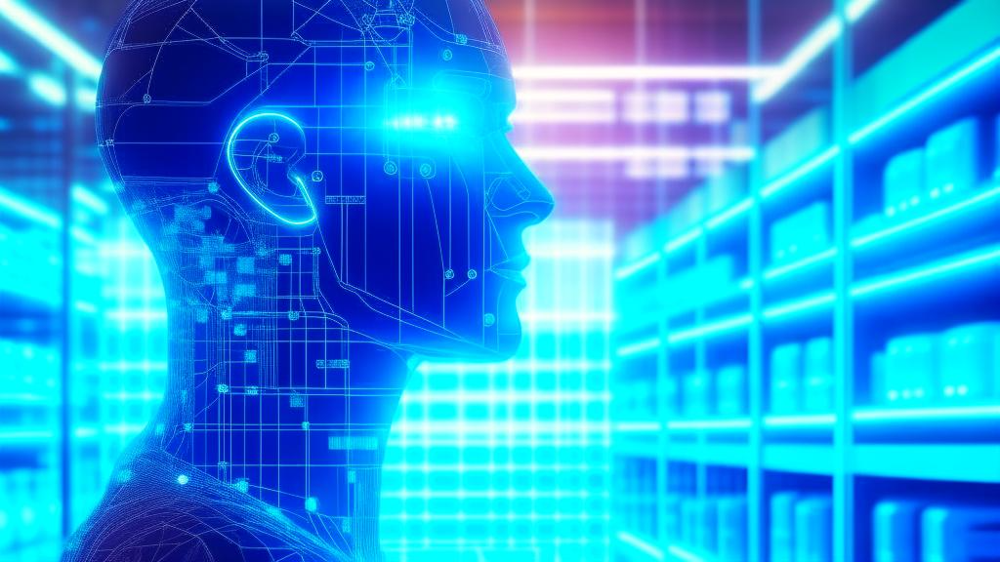

Мы будем использовать [**реальные данные о продажах**](https://www.kaggle.com/competitions/store-sales-time-series-forecasting/) сети магазинов **Favorita** из Эквадора.

**Обучающие данные** (`train.csv`), включающие **временные ряды признаков** `store_nbr`, `family` и `onpromotion`, а также **целевой признак** `sales`:
- `store_nbr` - идентификатор магазина, в котором продаются товары.
- `family` - семейство продаваемого товара.
- `sales` - общий объем продаж для семейства товаров в конкретном магазине на заданную дату. Возможны дробные значения, поскольку продукты могут продаваться в дробных единицах (например, 1,5 кг сыра в отличие от 1 пакета чипсов).
- `onpromotion` - общее количество товаров в семействе товаров, которые рекламировались в магазине на определенную дату.

**Дополнительные данные** о **праздничных днях** (`holidays_events.csv`):
- Праздники и события с метаданными.
- Дополнительные праздничные дни - это дни, добавленные к обычному календарному празднику, например, как это обычно бывает перед Рождеством (что делает канун Рождества выходным днем).

# 1. Загрузим и ознакомимся с данными

Импортируем необходимые библиотеки.

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import warnings

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

%matplotlib inline
plt.style.use('https://github.com/dhaitz/matplotlib-stylesheets/raw/master/pitayasmoothie-dark.mplstyle')
warnings.filterwarnings('ignore')

Подгрузка данных

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!unzip /content/drive/MyDrive/Data/store-sales-time-series-forecasting.zip -d /content/sales-ts-forecast

Archive:  /content/drive/MyDrive/Data/store-sales-time-series-forecasting.zip
  inflating: /content/sales-ts-forecast/holidays_events.csv  
  inflating: /content/sales-ts-forecast/oil.csv  
  inflating: /content/sales-ts-forecast/sample_submission.csv  
  inflating: /content/sales-ts-forecast/stores.csv  
  inflating: /content/sales-ts-forecast/test.csv  
  inflating: /content/sales-ts-forecast/train.csv  
  inflating: /content/sales-ts-forecast/transactions.csv  


Для этого проекта будем использовать данные только одного магазина и пяти семейств товаров.

In [4]:
df = pd.read_csv('/content/sales-ts-forecast/train.csv', index_col='id', parse_dates=['date'])
df = df.loc[(df['store_nbr'] == 1) & (df['family'].isin(['CLEANING', 'DELI', 'EGGS', 'MEATS', 'SEAFOOD'])),
 ['date', 'family', 'sales', 'onpromotion']].reset_index(drop=True)
df.head()

,date,family,sales,onpromotion
0,2013-01-01,CLEANING,0.0,0
1,2013-01-01,DELI,0.0,0
2,2013-01-01,EGGS,0.0,0
3,2013-01-01,MEATS,0.0,0
4,2013-01-01,SEAFOOD,0.0,0


Посмотрим общую информацию о данных.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8420 entries, 0 to 8419
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         8420 non-null   datetime64[ns]
 1   family       8420 non-null   object        
 2   sales        8420 non-null   float64       
 3   onpromotion  8420 non-null   int64         
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 263.2+ KB


Посмотрим статистические характеристики данных.

In [ ]:
df.describe().round(2)

,sales,onpromotion
count,8420.00,8420.00
mean,248.62,3.98
std,250.28,10.55
min,0.00,0.00
25%,76.92,0.00
50%,153.33,0.00
75%,300.55,1.00
max,1659.00,60.00


In [ ]:
df.describe(include=object)

,family
count,8420
unique,5
top,CLEANING
freq,1684


Проверим данные на наличие пропущеных значений и дубликатов.

In [ ]:
print('Количество пропущеных значений:', df.isna().sum().sum())
print('Количество дубликатов:', df.duplicated().sum())

Количество пропущеных значений: 0
Количество дубликатов: 0


Посмотрим временные границ данных.

In [ ]:
df['date'].agg(['min', 'max'])

min   2013-01-01
max   2017-08-15
Name: date, dtype: datetime64[ns]

Построим графики временных рядов для каждого семейства товаров.

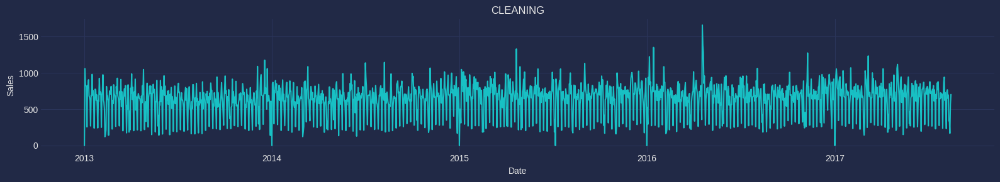

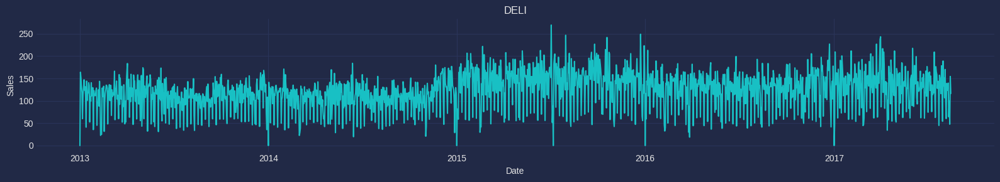

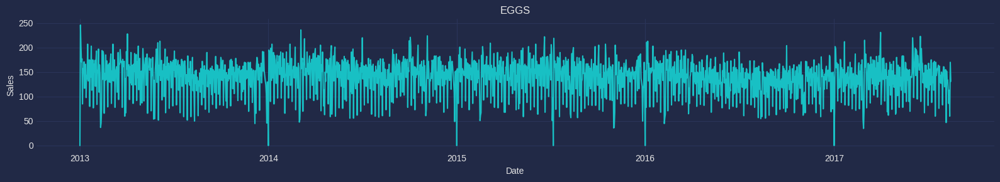

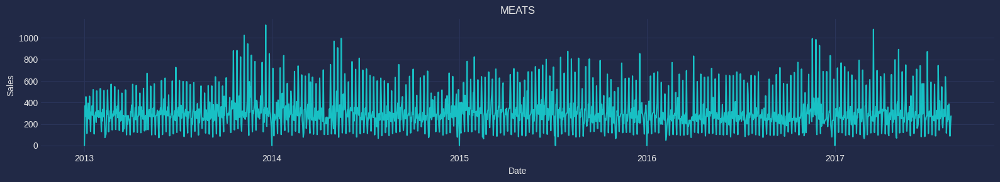

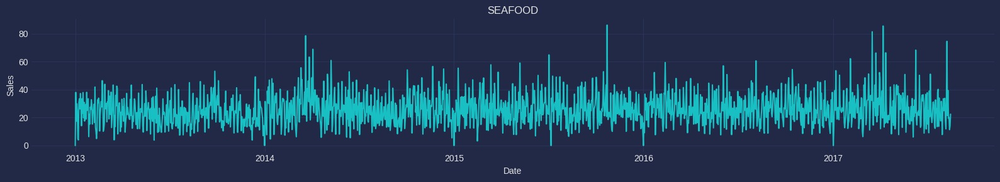

In [ ]:
for family, group in df.groupby('family'):
    plt.figure(figsize=(16, 3))
    plt.plot(group['date'], group['sales'])
    plt.title(family)
    plt.xlabel('Date')
    plt.ylabel('Sales')
    plt.tight_layout()
    plt.show()

Проверяем пропуски в датах временных рядов.

In [5]:
for family, group in df.groupby('family'):
    # Минимальные и максимальные даты во временном ряду
    min_date = group['date'].min()
    max_date = group['date'].max()

    # Создаём полный диапазон дат между минимальной и максимальной датами
    complete_date_range = pd.date_range(start=min_date, end=max_date, freq='D')

    # Проверяем наличие пропущенных дат во временном ряду
    missing_dates = complete_date_range[~complete_date_range.isin(group['date'])]

    if len(missing_dates) == 0:
        print(f'Нет пропущенных дат в {family}.')
    else:
        print(f'Пропущенные даты в {family}:')
        print(missing_dates)

Пропущенные даты в CLEANING:
DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)
Пропущенные даты в DELI:
DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)
Пропущенные даты в EGGS:
DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)
Пропущенные даты в MEATS:
DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)
Пропущенные даты в SEAFOOD:
DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)



- *В данных представленно 8420 записей 1 магазина, 5 семейств товаров за период с 2013-01-01 по 2017-08-15.*

- *В данных отсутствуют записи за 25 декабря 2013-2016 годов.*



---
# 2. Обработаем и очистим данные

Добавим в данные пропущенные даты, соответствующие им значения заполним нулями.

In [6]:
for family, group in df.groupby('family'):
    # Добавляем пропущенные даты в датафрейм
    for missing_date in missing_dates:
        df = df.append({'family': family, 'date': missing_date, 'sales': 0, 'onpromotion': 0}, ignore_index=True)

    # Сортируем датафрейм по датам
    df = df.sort_values('date')

Ещё раз проверяем отсутствие пропущенных дат, пропущенных значений и дубликатов.

In [7]:
for family, group in df.groupby('family'):
    # Проверяем наличие пропущенных дат во временном ряду
    missing_dates = complete_date_range[~complete_date_range.isin(group['date'])]

    if len(missing_dates) == 0:
        print(f'Нет пропущенных дат в категории {family}')
    else:
        print(f'Пропущенные даты в категории {family}:')
        print(missing_dates)

print('\nКоличество пропущеных значений:', df.isna().sum().sum())
print('Количество дубликатов:', df.duplicated().sum())

Нет пропущенных дат в категории CLEANING
Нет пропущенных дат в категории DELI
Нет пропущенных дат в категории EGGS
Нет пропущенных дат в категории MEATS
Нет пропущенных дат в категории SEAFOOD

Количество пропущеных значений: 0
Количество дубликатов: 0




---
# 3. Применим статистические методы для анализа данных

Построим графики декомпозиции временных рядов.

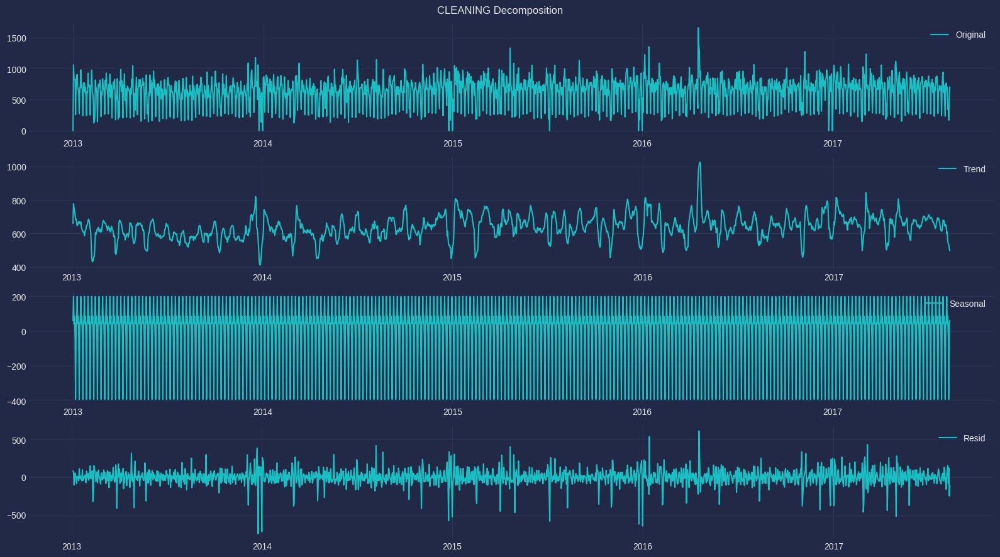

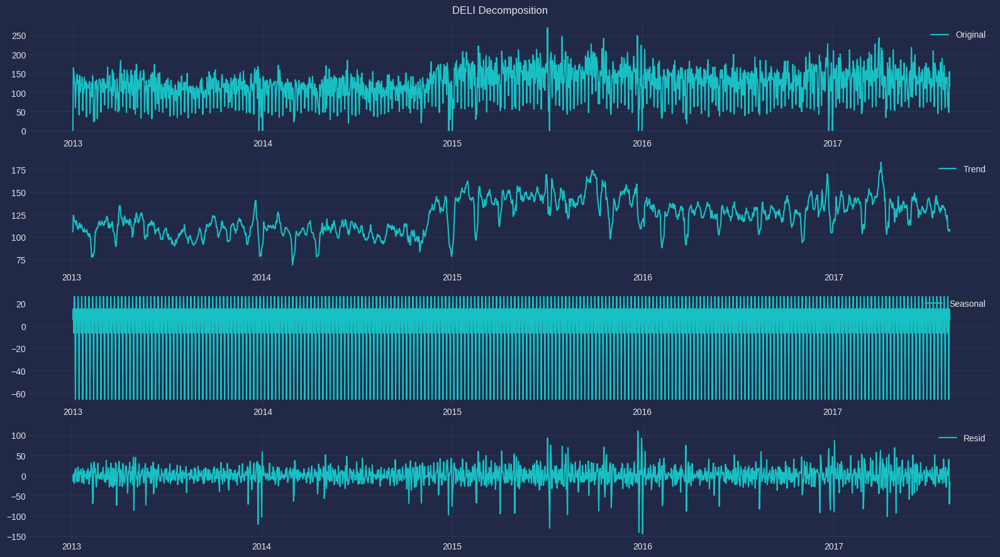

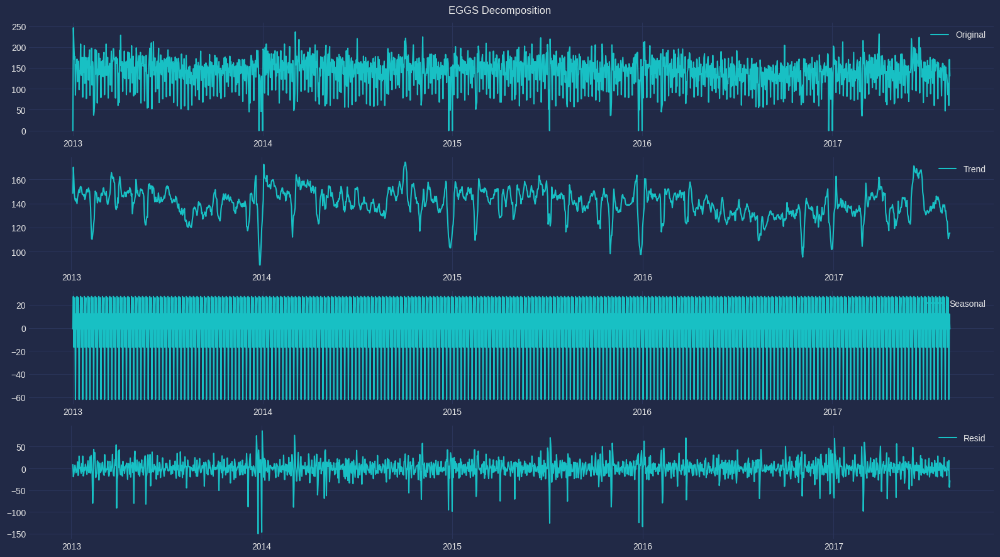

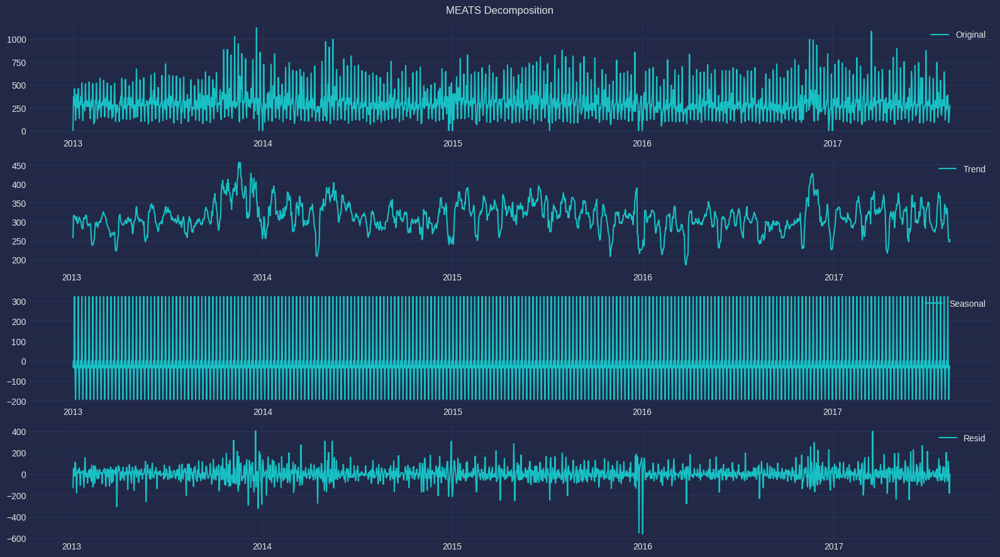

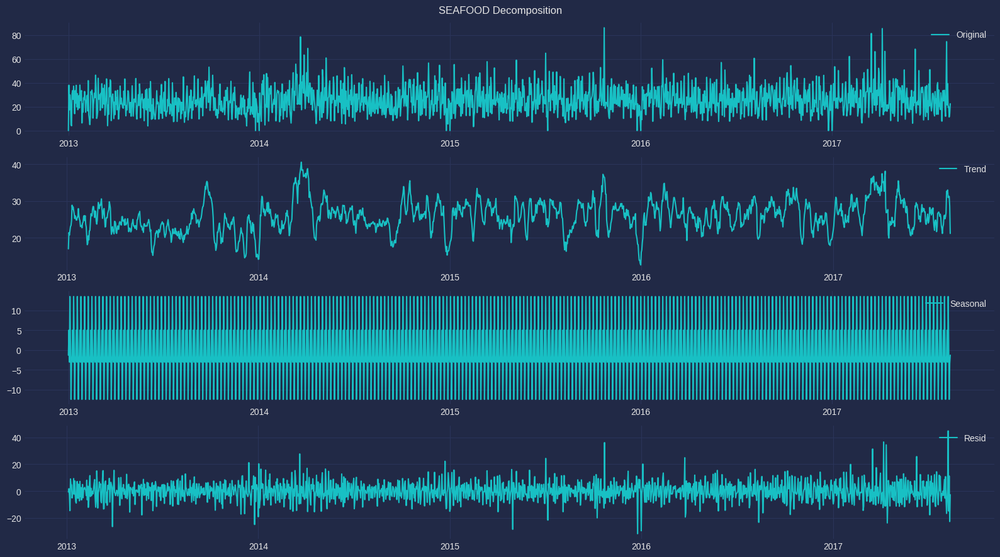

In [ ]:
for family, group in df.groupby('family'):
    ts = group.set_index('date').sales

    # Декомпозиция временного ряда
    decomposition = seasonal_decompose(ts, model='additive')

    # Построение декомпозиции
    plt.figure(figsize=(16, 9))
    plt.subplot(411)
    plt.plot(ts, label='Original')
    plt.legend(loc='upper right')
    plt.subplot(412)
    plt.plot(decomposition.trend, label='Trend')
    plt.legend(loc='upper right')
    plt.subplot(413)
    plt.plot(decomposition.seasonal, label='Seasonal')
    plt.legend(loc='upper right')
    plt.subplot(414)
    plt.plot(decomposition.resid, label='Resid')
    plt.legend(loc='upper right')
    plt.suptitle(f'{family} Decomposition')
    plt.tight_layout()
    plt.show()

- *Временные ряды всех рассмтриваемых семейств товаров имеют нелинейный тренд, сезонность с частотой 7 дней и остатки, похожие на белый шум.*

Проверим временные ряды на стационарность с помощью теста Дики-Фуллера.

In [ ]:
# Функция для проверки временного рядя на стационарность с помощью теста Дики-Фуллера
def augmented_dickey_fuller_test(series , column_name):
    print (f'Dickey-Fuller test results for columns: {column_name}')
    dftest = adfuller(series, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','No Lags Used','Number of observations used'])
    for key,value in dftest[4].items():
       dfoutput['Critical Value (%s)'%key] = value
    print (dfoutput)
    if dftest[1] <= 0.05:
        print(f"{column_name} данные стационарные.")
    else:
        print(f"{column_name} данные нестационарные.")

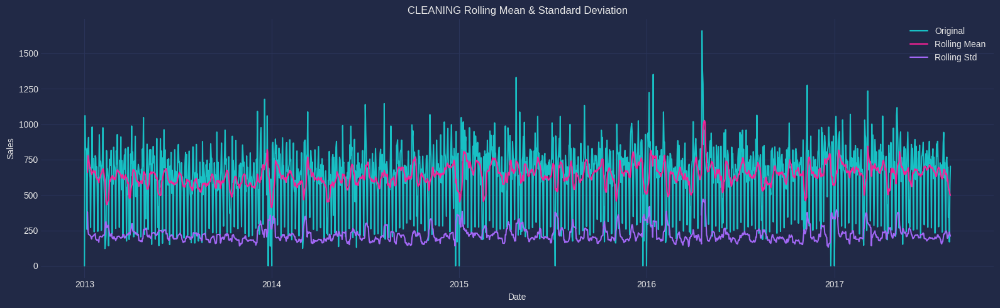

Dickey-Fuller test results for columns: CLEANING
Test Statistic                -7.927906e+00
p-value                        3.577442e-12
No Lags Used                   2.300000e+01
Number of observations used    1.664000e+03
Critical Value (1%)           -3.434286e+00
Critical Value (5%)           -2.863278e+00
Critical Value (10%)          -2.567696e+00
dtype: float64
CLEANING данные стационарные.


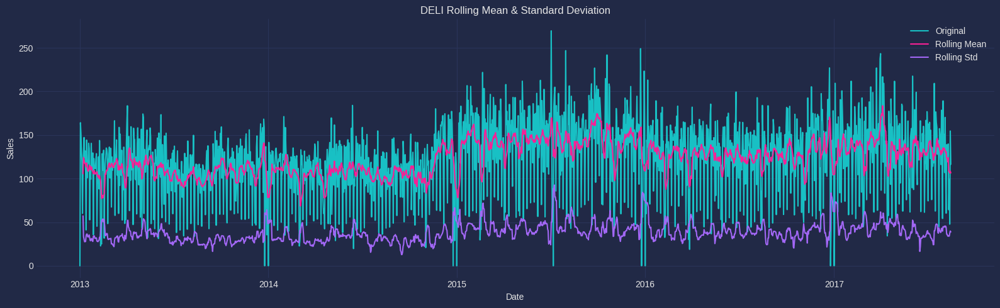

Dickey-Fuller test results for columns: DELI
Test Statistic                   -3.740673
p-value                           0.003576
No Lags Used                     21.000000
Number of observations used    1666.000000
Critical Value (1%)              -3.434281
Critical Value (5%)              -2.863276
Critical Value (10%)             -2.567694
dtype: float64
DELI данные стационарные.


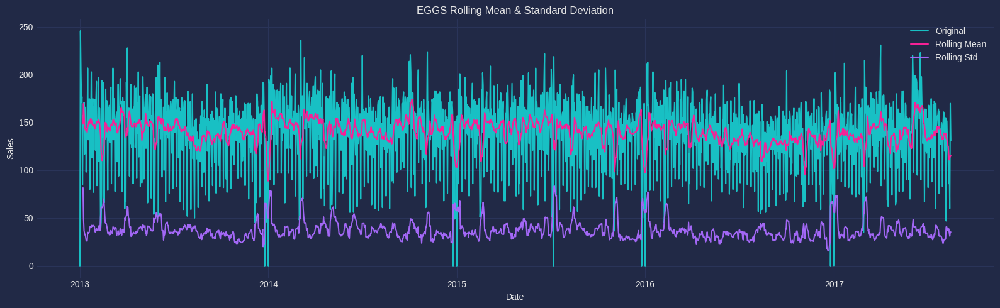

Dickey-Fuller test results for columns: EGGS
Test Statistic                -6.525339e+00
p-value                        1.017948e-08
No Lags Used                   2.100000e+01
Number of observations used    1.666000e+03
Critical Value (1%)           -3.434281e+00
Critical Value (5%)           -2.863276e+00
Critical Value (10%)          -2.567694e+00
dtype: float64
EGGS данные стационарные.


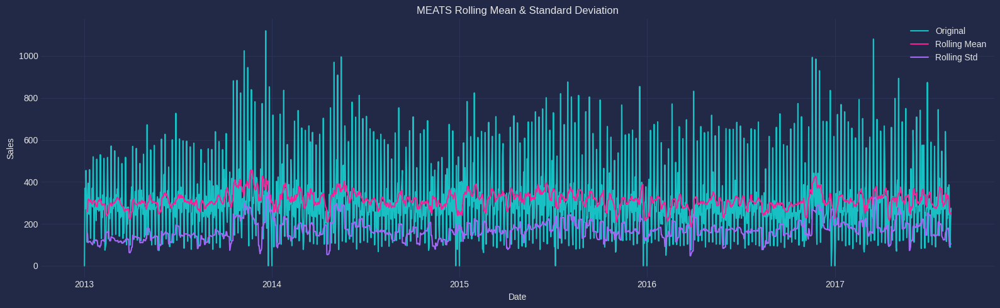

Dickey-Fuller test results for columns: MEATS
Test Statistic                -6.571181e+00
p-value                        7.928889e-09
No Lags Used                   2.200000e+01
Number of observations used    1.665000e+03
Critical Value (1%)           -3.434284e+00
Critical Value (5%)           -2.863277e+00
Critical Value (10%)          -2.567695e+00
dtype: float64
MEATS данные стационарные.


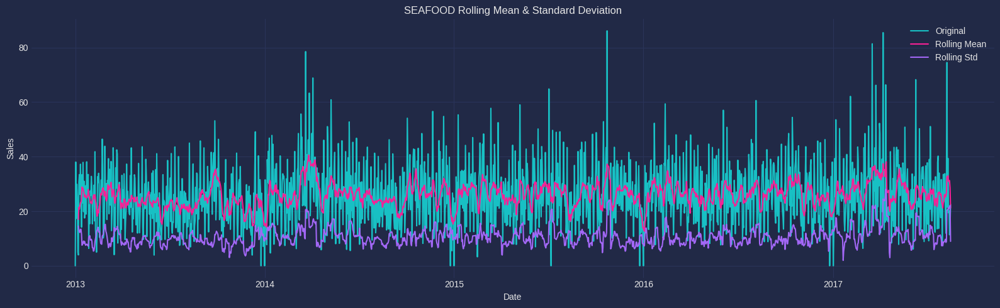

Dickey-Fuller test results for columns: SEAFOOD
Test Statistic                -6.944425e+00
p-value                        1.005716e-09
No Lags Used                   2.300000e+01
Number of observations used    1.664000e+03
Critical Value (1%)           -3.434286e+00
Critical Value (5%)           -2.863278e+00
Critical Value (10%)          -2.567696e+00
dtype: float64
SEAFOOD данные стационарные.


In [ ]:
# Группируем данные по семейству товаров и проверяем каждый временной ряд
for family, group in df.groupby('family'):
    ts = group.set_index('date').sales

    # Оцениваем скользящее среднее и стандартное отклонение
    rolmean = ts.rolling(window=7).mean()
    rolstd = ts.rolling(window=7).std()

    # Строим график скользящего среднего и стандартного отклонения
    fig, ax = plt.subplots(figsize=(16, 5))
    ax.plot(ts, label='Original')
    ax.plot(rolmean, label='Rolling Mean')
    ax.plot(rolstd, label='Rolling Std')
    ax.legend(loc='upper right')
    ax.set_title(f'{family} Rolling Mean & Standard Deviation')
    ax.set_xlabel('Date')
    ax.set_ylabel('Sales')
    plt.tight_layout()
    plt.show()

    # Применяем тест Дики-Фуллера
    augmented_dickey_fuller_test(ts, family)

- *Результаты теста Дики-Фуллера указывают на стационарность рассматриваемых временных рядов.*

Построим графики автокорреляции и частичной автокорреляции.

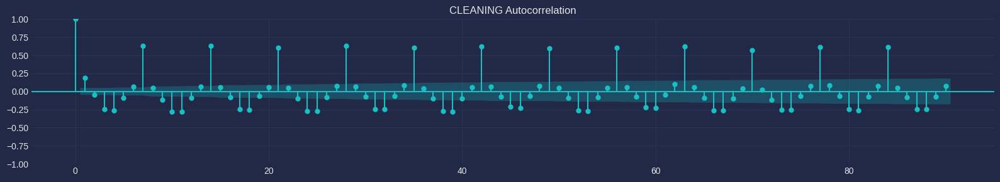

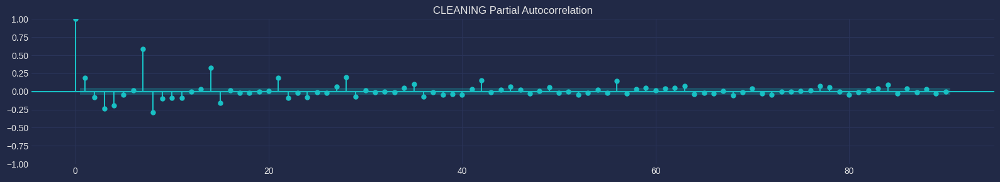

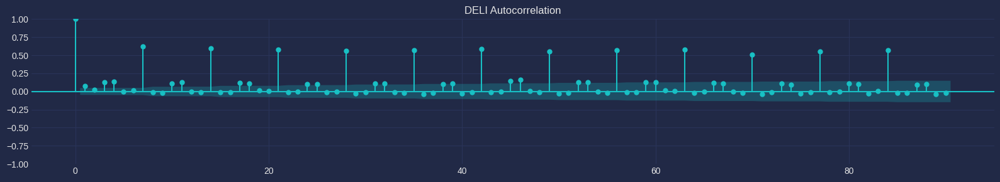

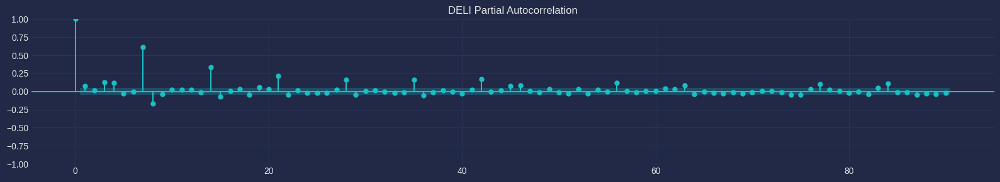

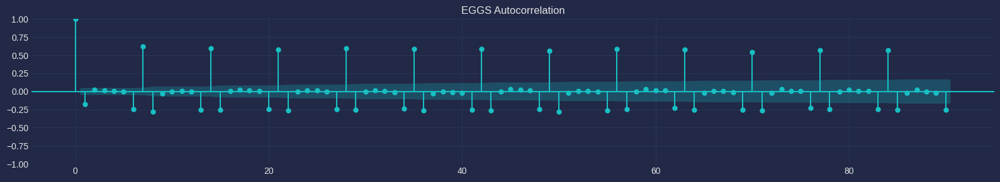

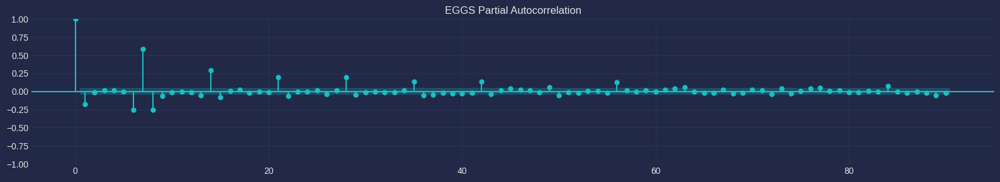

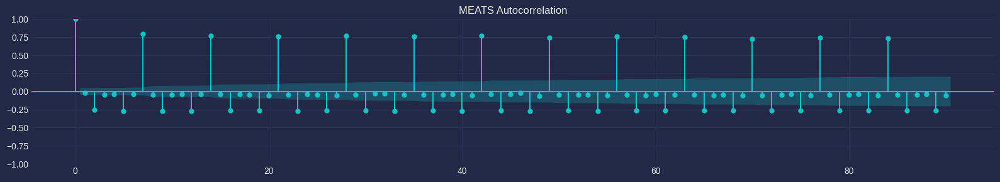

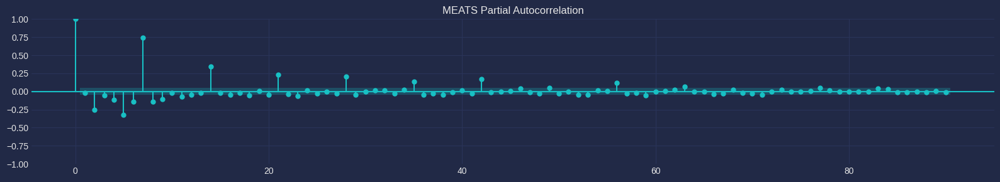

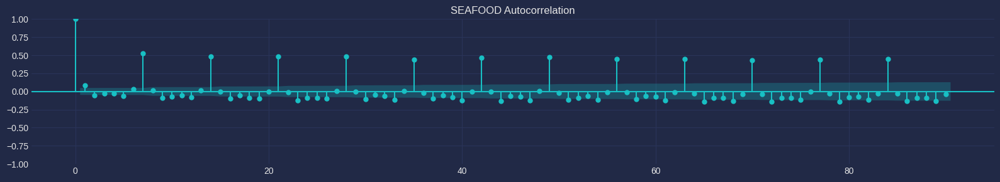

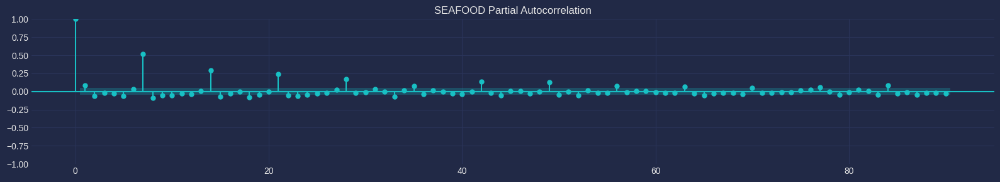

In [ ]:
for family, group in df.groupby('family'):
    ts = group.set_index('date').sales

    # Строим график автокорреляции
    fig, ax = plt.subplots(figsize=(16, 3))
    plot_acf(ts, lags=90, ax=ax)
    ax.set_title(f'{family} Autocorrelation')
    fig.tight_layout()

    # Строим график частичной автокорреляции
    fig, ax = plt.subplots(figsize=(16, 3))
    plot_pacf(ts, lags=90, ax=ax)
    ax.set_title(f'{family} Partial Autocorrelation')
    fig.tight_layout()
    plt.show()

- *В временных рядах всех рассматриваемых семейств товаров присутствует недельная сезонность (лаги, кратные 7 дням).*

Построим QQ-plot для каждого семейства товаров.

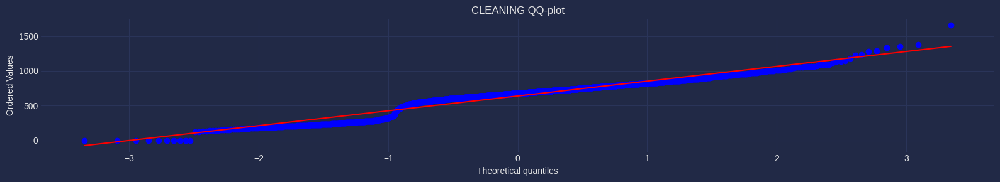

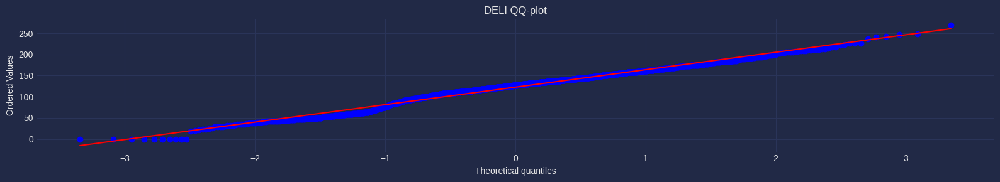

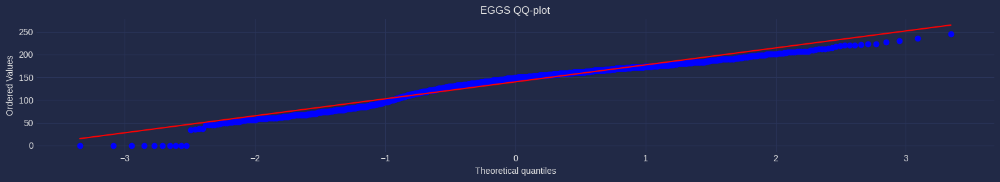

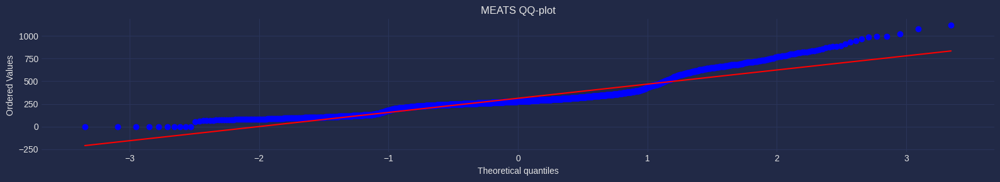

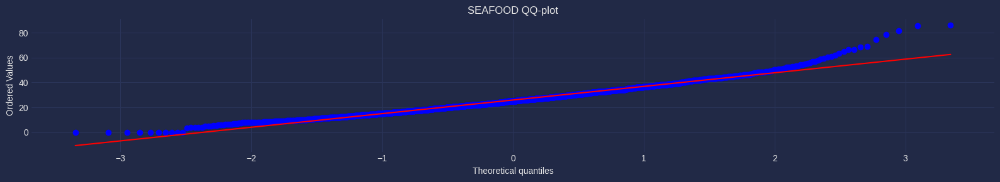

In [ ]:
for family, group in df.groupby('family'):
    plt.figure(figsize=(16, 3))
    stats.probplot(group['sales'], dist="norm", plot=plt)
    plt.title(f'{family} QQ-plot')
    plt.tight_layout()
    plt.show()

- *Распределения продаж по семействам товаров отличаются от нормального.*



---
# 4. Применим инструменты визуализации

Напишем функцию для построения графиков зависимости продаж от выбранного таймфрейма (день недели, месяц, день месяца, неделя, день года).

In [ ]:
def plot_sales_by_timeframe(data, timeframe):
    if timeframe == 'year':
        timeframe_name = 'Year'
        x_axis = data.date.dt.year
    elif timeframe == 'weekday':
        timeframe_name = 'Day of Week'
        x_axis = data.date.dt.day_name()
    elif timeframe == 'month':
        timeframe_name = 'Month'
        x_axis = data.date.dt.month_name()
    elif timeframe == 'day':
        timeframe_name = 'Day of Month'
        x_axis = data.date.dt.day
    elif timeframe == 'week':
        timeframe_name = 'Week'
        x_axis = data.date.dt.week
    elif timeframe == 'dayofyear':
        timeframe_name = 'Day of Year'
        x_axis = data.date.dt.dayofyear
    else:
        print('Invalid timeframe entered')
        return

    for family, group in data.groupby('family'):
        _, ax = plt.subplots(figsize=(16, 3))
        sns.boxplot(x=x_axis, y=group.sales, ax=ax)
        plt.title(f'{family} Sales by {timeframe_name}')
        plt.xlabel(timeframe_name)
        plt.ylabel('Sales')
        plt.tight_layout()
        plt.show()

Построим графики зависимости продаж от года.

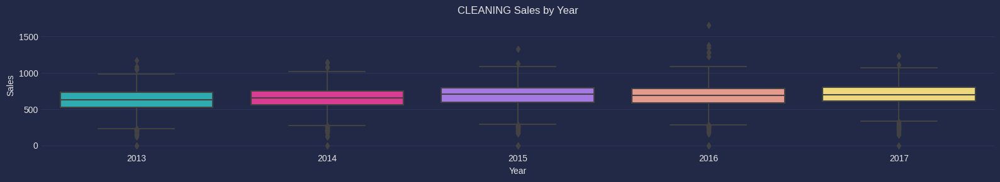

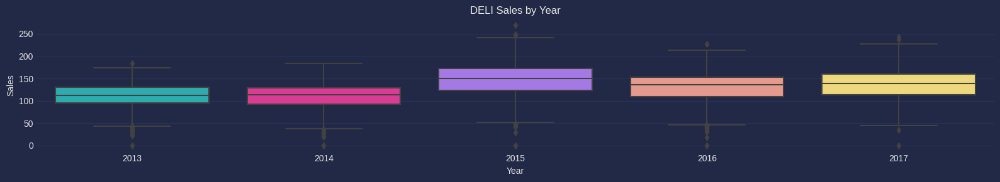

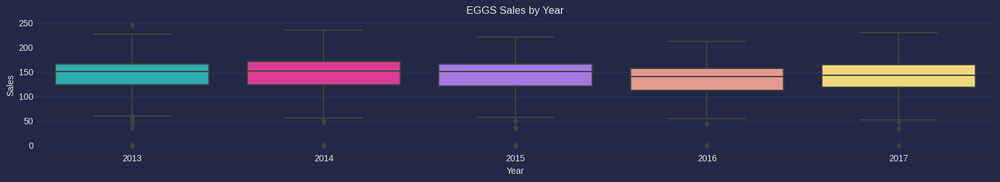

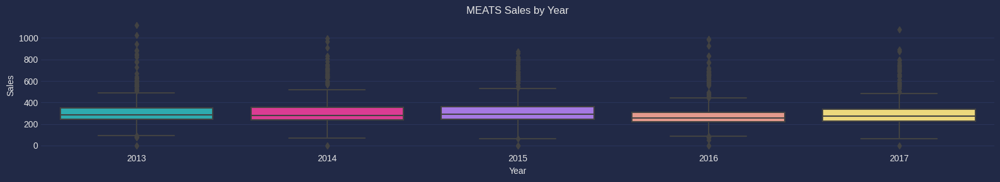

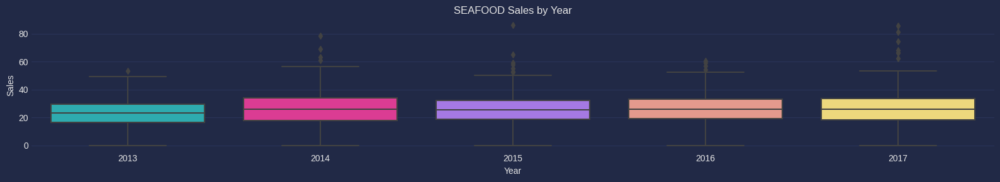

In [ ]:
plot_sales_by_timeframe(df, 'year')

Построим графики зависимости продаж от дня недели.

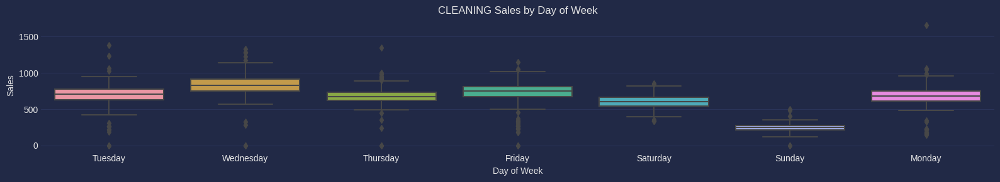

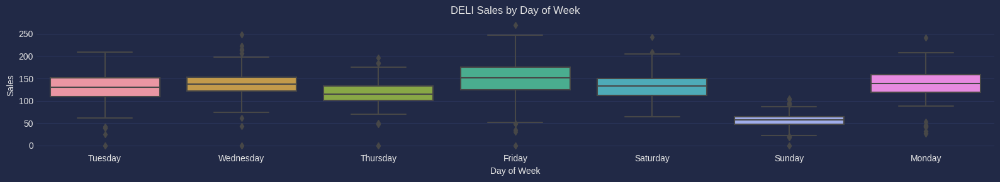

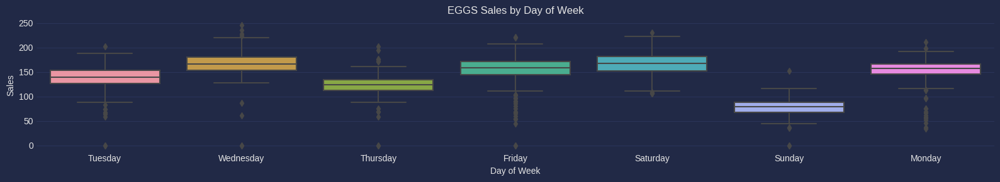

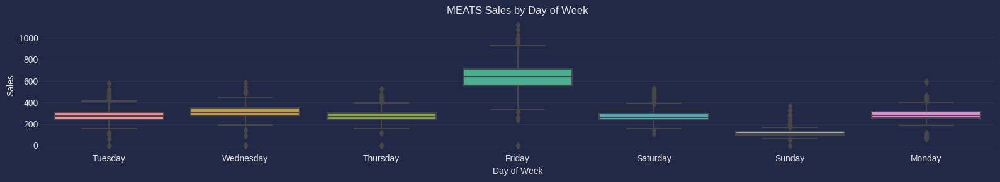

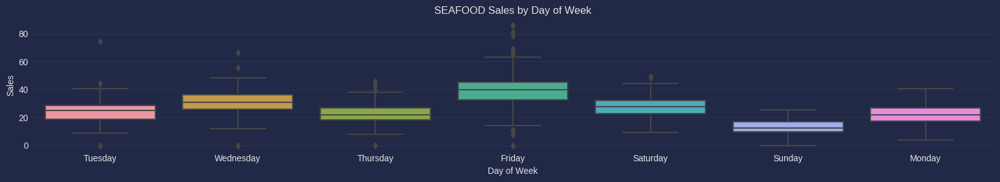

In [ ]:
plot_sales_by_timeframe(df, 'weekday')

- *В среду и пятницу самые высокие продажи.*
- *В воскременье самые низкие продажи.*

Построим графики зависимости продаж от месяца.

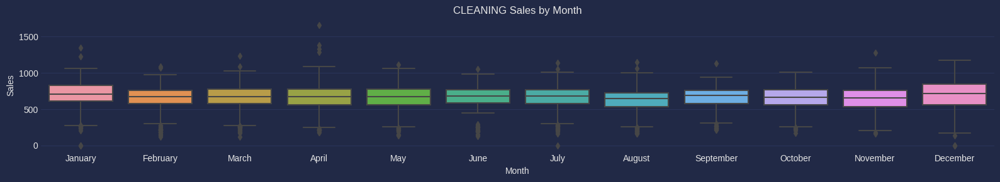

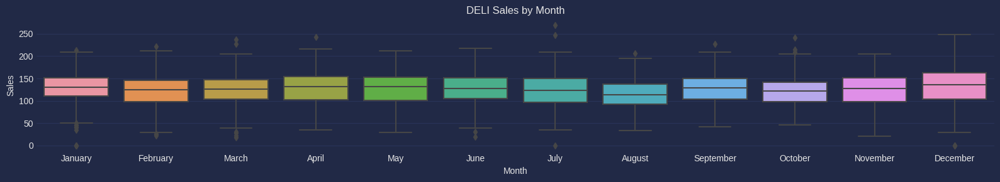

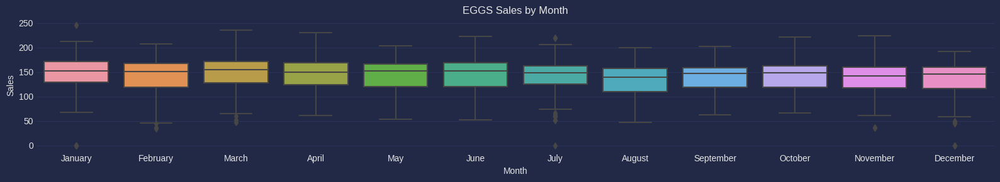

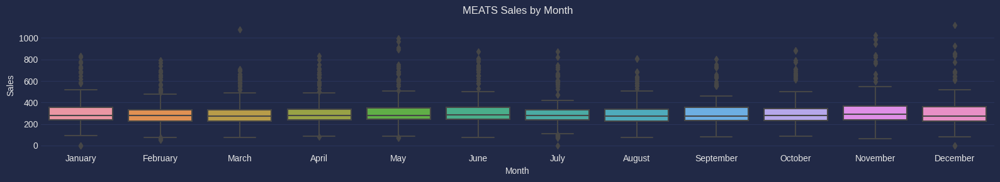

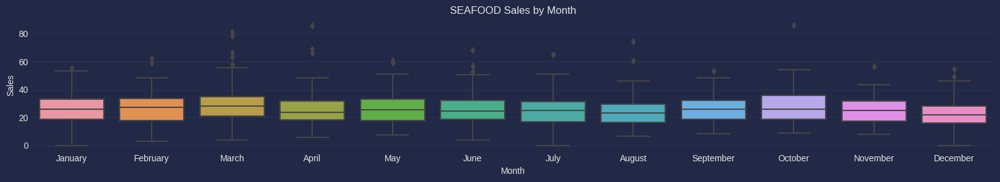

In [ ]:
plot_sales_by_timeframe(df, 'month')

- *В среднем продажи в феврале, августе, сентябре, октябре, ноябре, декабре ниже, чем в остальные месяцы.*

Построим графики зависимости продаж от дня месяца.

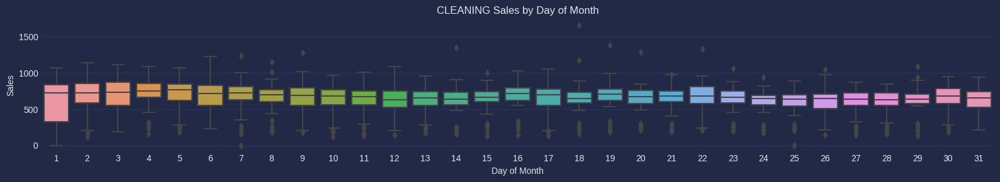

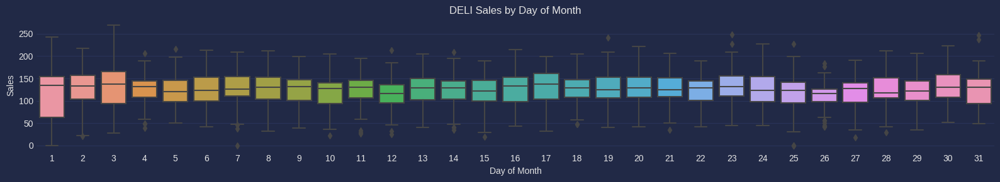

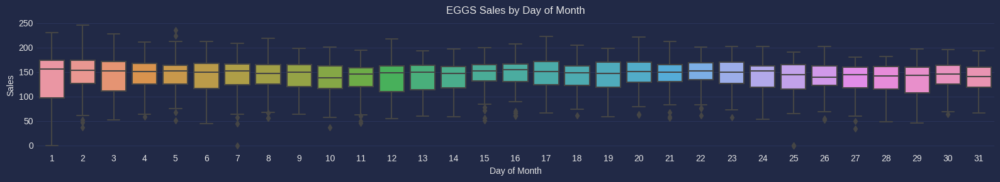

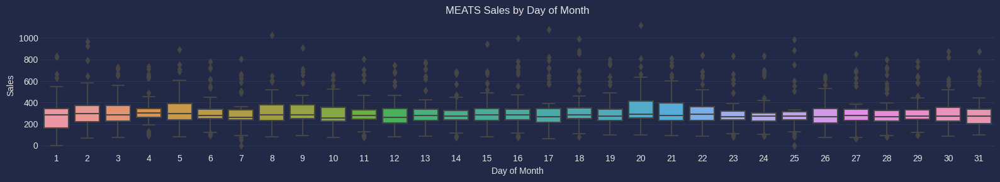

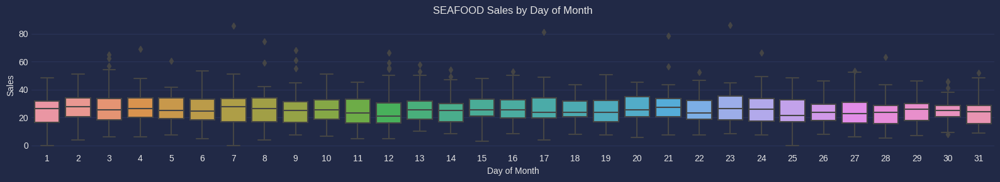

In [ ]:
plot_sales_by_timeframe(df, 'day')

- *В зависимости от дня месяца есть закономерности в повышенных/пониженных продажах товаров: самые низкие продажи в 31 день месяца (всего 7 дней в году), в 1, 25, 29, 30 дни месяца продажи ниже средних продаж.*
- *Продажи от начала к концу месяца снижаются.*

Построим графики зависимости продаж от недели.

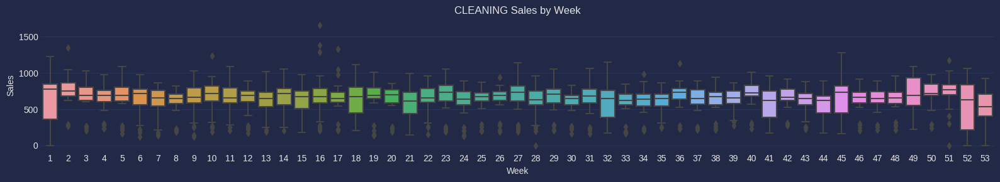

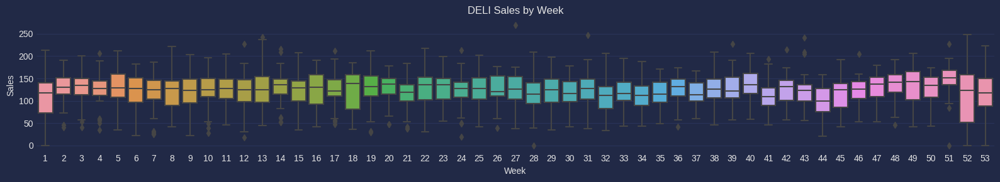

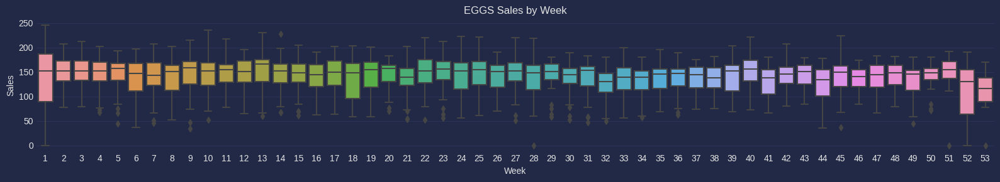

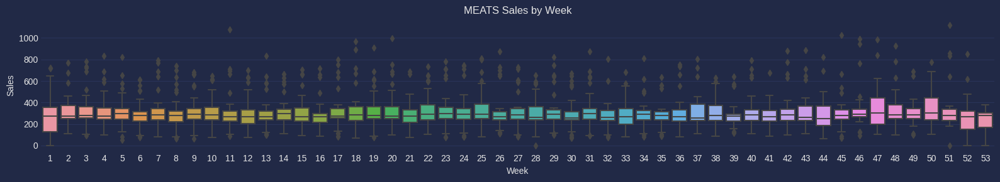

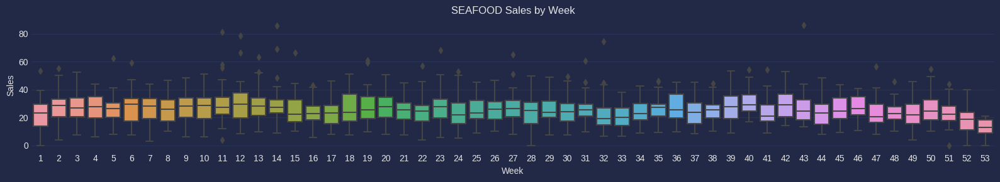

In [ ]:
plot_sales_by_timeframe(df, 'week')

- Самые низкие продажи на 52, 53 (неполная) неделях.
- В зависимости от семейства товаров ежегодные недельные продажи немного отличаются, но в среднем от начала к концу года продажи снижаются.

Построим графики зависимости продаж от дня года.

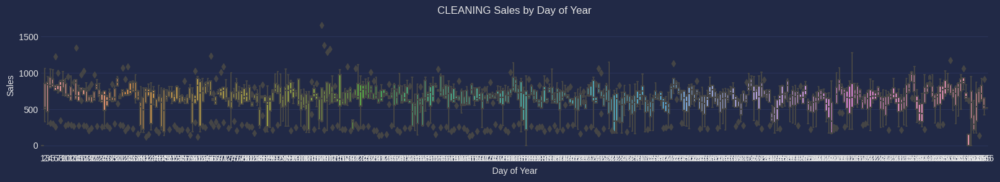

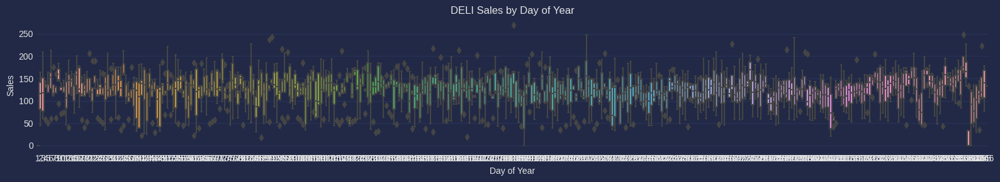

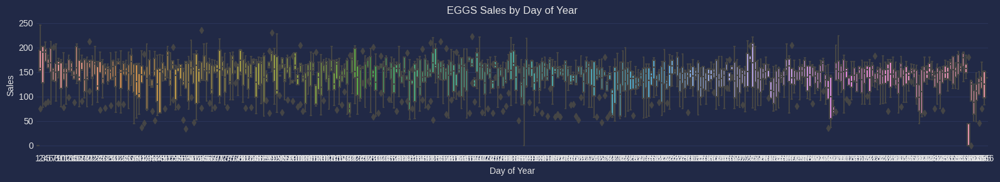

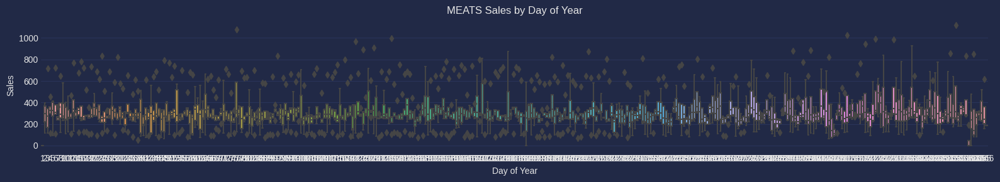

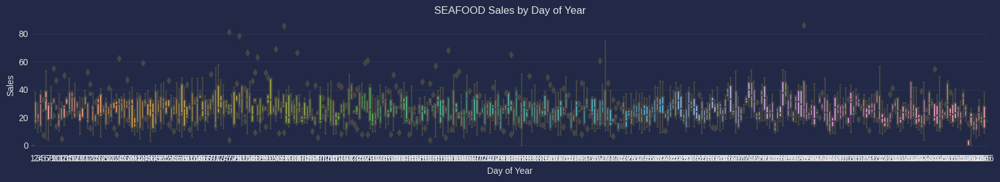

In [ ]:
plot_sales_by_timeframe(df, 'dayofyear')

- *В данных присутствует повышенные/пониженные продажи в одни и те же дни года.*
- *В данные присутствуют дни, в которых ежегодно нет продаж  - видимо, это праздничные дни, когда магазин закрыт.*

Построим графики зависимости продаж от количества рекламируемых товаров.

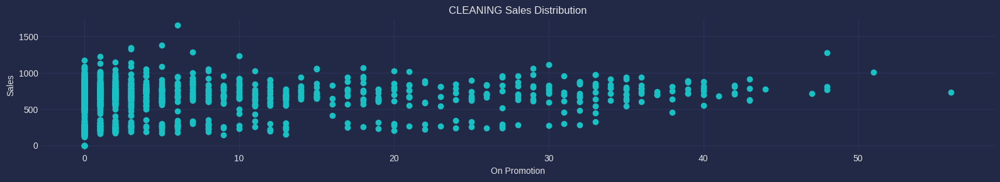

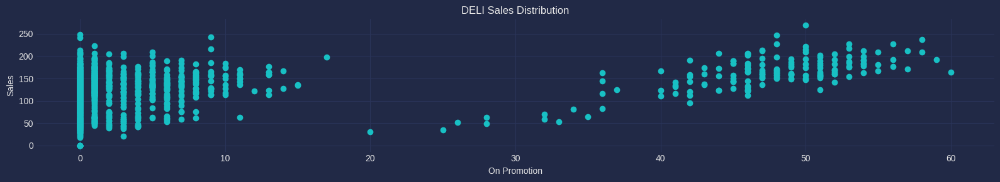

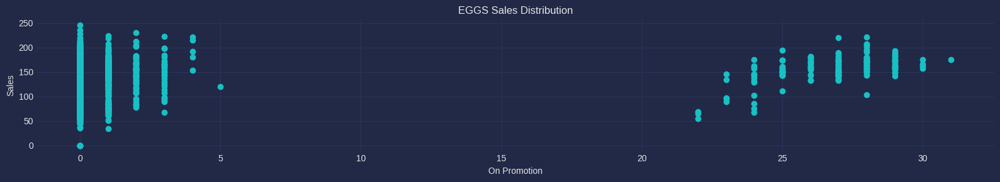

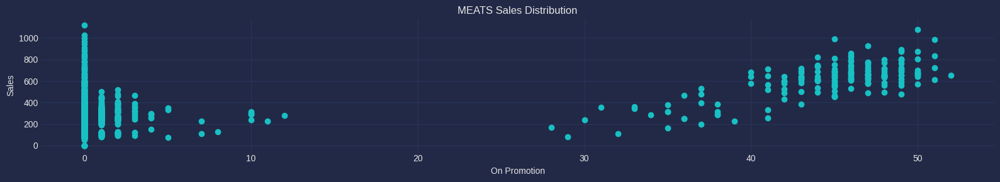

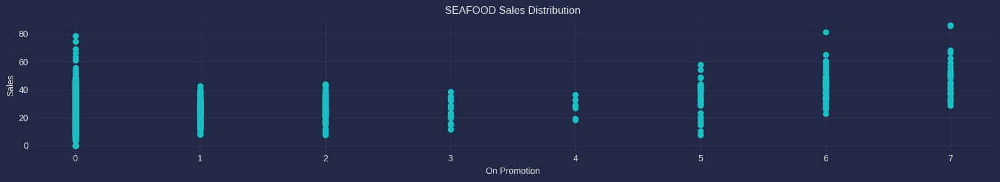

In [ ]:
# Построение scatter plot для каждого семейства товаров
for family, group in df.groupby('family'):
    plt.figure(figsize=(16, 3))
    plt.title(f'{family} Sales Distribution')
    plt.xlabel('On Promotion')
    plt.ylabel('Sales')
    plt.scatter(group['onpromotion'], group['sales'])
    plt.tight_layout()
    plt.show()

- *При увеличении количества рекламируемых товаров уменьшается количество продаж, но в некоторых случаях дальнейшее увеличение количества рекламируемых товаров приводит к сравнительно небольшому увеличению продаж.*


---
# 5. Применим машинное обучение и глубокое обучение

Устанавливаем необходимые библиотеки.

In [ ]:
%%capture
!pip install gluonts
!pip install lightgbm
!pip install mlforecast
!pip install neuralforecast
!pip install optuna
!pip install pytorch-lightning
!pip install statsforecast
!pip install window-ops
!pip install xgboost

Импортируем необходимые библиотеки.

In [ ]:
import joblib, optuna, pickle, torch

from gluonts.dataset.pandas import PandasDataset
from gluonts.torch.model.deepar import DeepAREstimator
from joblib import Parallel, delayed
from lightgbm import LGBMRegressor
from mlforecast import MLForecast
from neuralforecast import NeuralForecast
from neuralforecast.auto import AutoTCN
from neuralforecast.models import GRU, LSTM, NBEATS
from neuralforecast.losses.pytorch import DistributionLoss
from numba import njit
from prophet import Prophet
from prophet.serialize import model_to_json, model_from_json
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.model_selection import TimeSeriesSplit
from statsforecast import StatsForecast
from statsforecast.models import AutoARIMA, Naive, SeasonalNaive, SeasonalWindowAverage, WindowAverage
from tqdm.autonotebook import tqdm
from window_ops.rolling import rolling_mean, rolling_max, rolling_min
from xgboost import XGBRegressor

Напишем функцию для вычисления **средневзвешенной абсолютной процентной ошибки** (*WMAPE: Weighted Mean Absolute Percentage Error*) с абсолютными значениями фактических значений в качестве весов, чтобы измерять производительность моделей.

Это адаптированная версия **средней абсолютной процентной ошибки** (*MAPE: Mean Absolute Percentage Error*), которая решает проблему деления на ноль, когда продаж за определенный день нет.

In [22]:
def wmape(y_true, y_pred):
    return np.abs(y_true - y_pred).sum() / np.abs(y_true).sum()

Напишем функцию для вычисления разностных признаков с использованием `numba` (библиотека, которая оптимизирует код на Python для более быстрой работы, и разработчики `mlforecast` рекомендуют ее при создании пользовательских функций для вычисления возможностей.).

In [24]:
@njit
def diff(x, lag):
    x2 = np.full_like(x, np.nan)
    for i in range(lag, len(x)):
        x2[i] = x[i] - x[i-lag]
    return x2

Напишем функцию для построения графиков прогнозов моделей и истинных значений.

In [46]:
def plot_forecasts(df):
    for model in [col for col in df.columns if col not in ['ds', 'unique_id', 'y', 'onpromotion']]:
        fig, ax = plt.subplots(df['unique_id'].nunique(), 1, figsize=(16, 18))
        for ax_, family in enumerate(df['unique_id'].unique()):
            FAMILY = df.loc[df['unique_id'] == family]
            FAMILY.plot(x='ds', y='y', ax=ax[ax_], label='y')
            FAMILY.plot(x='ds', y=model, ax=ax[ax_], label=model)
            ax[ax_].set_xlabel('Date')
            ax[ax_].set_ylabel('Sales')
            ax[ax_].set_title(f'{family} Forecast')
            ax[ax_].legend(loc='upper right')
        fig.tight_layout()

Напишем функцию для создания сводной таблицы прогнозов моделей по семействам товаров.

In [ ]:
def get_pivot_table(df):
    results = pd.DataFrame()
    for family, group in df.groupby('unique_id'):
        for model in [col for col in df.columns if col not in ['ds', 'unique_id', 'y']]:
            error = wmape(group['y'], group[model]) * 100
            results = results.append({'family': family, 'model': model, 'error': error}, ignore_index=True)
    pivot_table = pd.pivot_table(results, values='error', index='family', columns='model', aggfunc=np.mean)
    return pivot_table.style.highlight_min(axis=1)

Переименуем названия столбцов, так как некоторые модели ожидают, что столбцы будут названы в следующем формате:
- `ds`: дата записи,
- `y`: целевая переменная (объем продаж),
- `unique_id`: уникальный идентификатор временного ряда (категория продукта).

In [ ]:
df = df.rename(columns={'date': 'ds', 'family': 'unique_id', 'sales': 'y'})
df.head()

,ds,unique_id,y,onpromotion
0,2013-01-01,CLEANING,0.0,0
1,2013-01-01,DELI,0.0,0
2,2013-01-01,EGGS,0.0,0
3,2013-01-01,MEATS,0.0,0
4,2013-01-01,SEAFOOD,0.0,0


Разделим данные временных рядов на **тренировочные** и **валидационные выборки**. При обучении моделей будем учитывать, что некоторые из них не могут использовать дополнительные признаки (`onpromotion`).

Нашим обучающим набором будут все данные за период с 2013 по 2016 год, а нашим проверочным набором будут первые 3 месяца 2017 года.

`h` - это горизонт, количество периодов, которые мы хотим спрогнозировать.

In [ ]:
train = df.loc[df['ds'] < '2017-01-01']
valid = df.loc[(df['ds'] >= '2017-01-01') & (df['ds'] < '2017-04-01')]

h = valid['ds'].nunique()

## NAIVE

- **Простой наивный прогноз** (`Naive`):
Простая наивная модель предсказывает следующие значения как последнее наблюдаемое значение.

- **Сезонный наивный прогноз** (`SeasonalNaive`):
Сезонная наивная модель использует последнее наблюдаемое значение за аналогичный период в прошлом.

- **Средний прогноз по сезонному окну** (`SeasonalWindowAverage`):
Модель среднего значения сезонного окна использует среднее значение последних значений `window_size` за аналогичный период в прошлом.

- **Средний прогноз по окну** (`WindowAverage`):
Модель среднего прогноза по окну использует среднее значение последних значений `window_size` серии.

Построим модели наивного прогнозирования с помощью библиотеки `StatsForecast`. Будем использовать недельную сезонностью `season_length=7` и размер окна `window_size=7`.

In [ ]:
model_naive = StatsForecast(models=[
    Naive(),
    SeasonalNaive(season_length=7),
    SeasonalWindowAverage(season_length=7, window_size=7),
    WindowAverage(window_size=7)
    ], freq='D', n_jobs=-1)
model_naive.fit(train[['ds', 'unique_id', 'y']])

pred_naive = model_naive.forecast(h=h)
pred_naive = pred_naive.reset_index().merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')
pred_naive.head()

,unique_id,ds,Naive,SeasonalNaive,SeasWA,WindowAverage,y
0,CLEANING,2017-01-01,518.0,0.0,272.571442,567.0,0.0
1,CLEANING,2017-01-02,518.0,234.0,666.428528,567.0,332.0
2,CLEANING,2017-01-03,518.0,876.0,700.428589,567.0,952.0
3,CLEANING,2017-01-04,518.0,791.0,868.571411,567.0,1055.0
4,CLEANING,2017-01-05,518.0,634.0,722.714233,567.0,918.0


Построим графики прогнозов моделей и истинных значений.

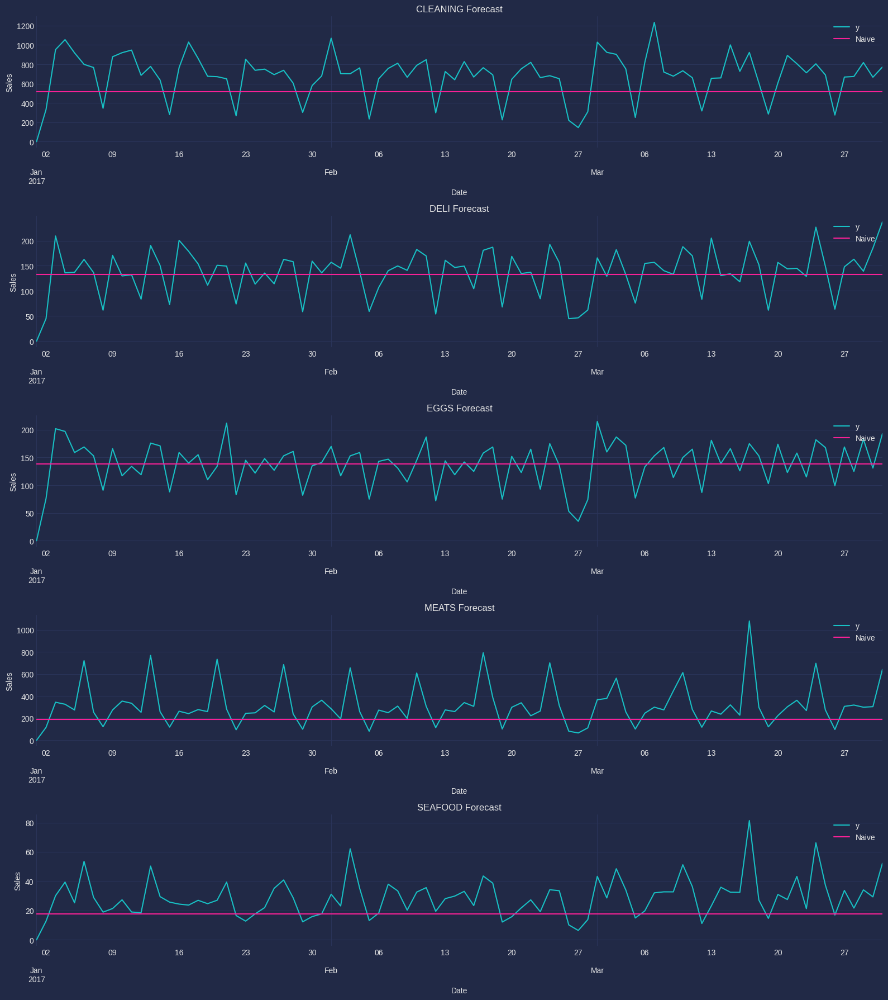

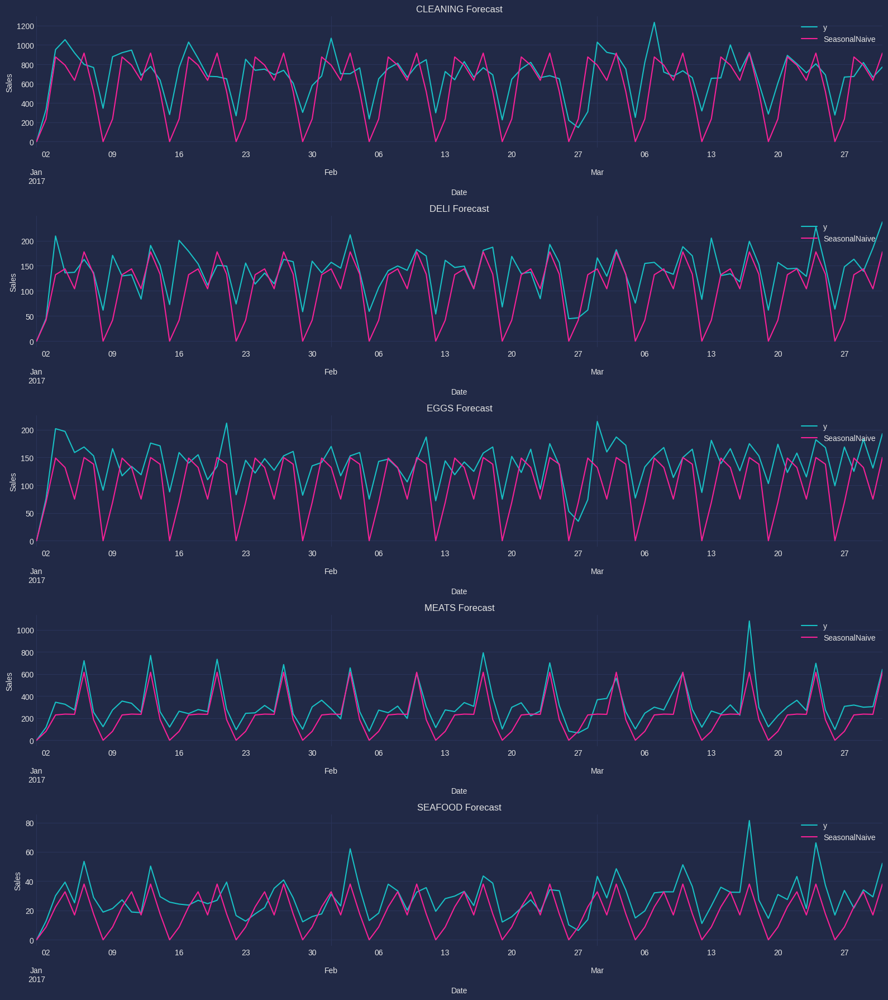

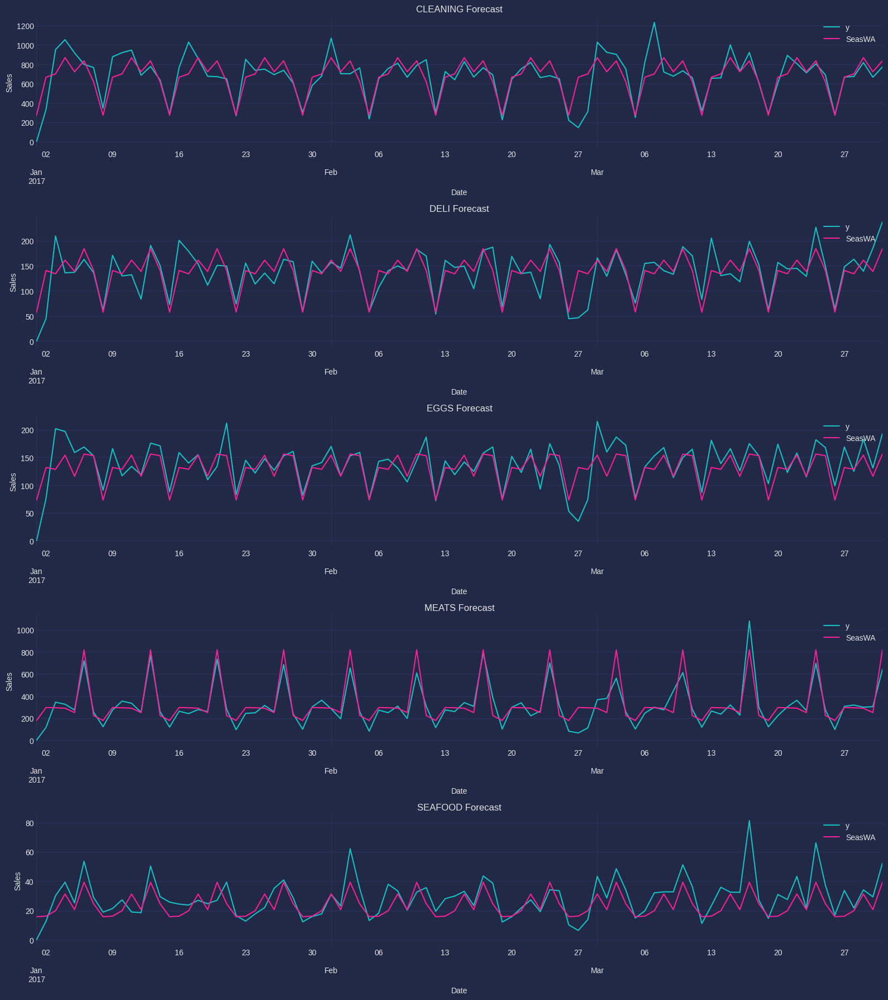

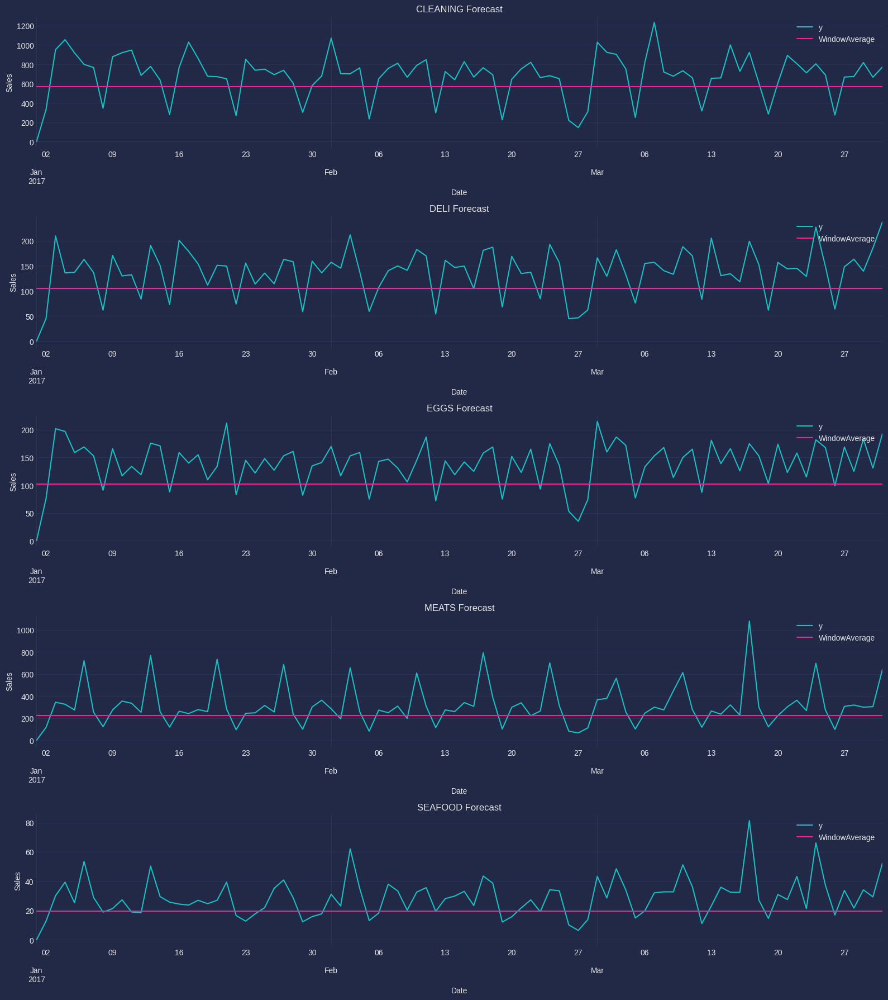

In [47]:
plot_forecasts(pred_naive)

Создадим сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [36]:
get_pivot_table(pred_naive)

model,Naive,SeasWA,SeasonalNaive,WindowAverage
family,,,,
CLEANING,37.493661,14.353714,29.054684,32.844781
DELI,26.073904,15.713238,27.614895,36.201118
EGGS,22.446020,13.800009,31.703190,33.711617
MEATS,50.838618,21.915593,30.236218,43.354514
SEAFOOD,44.928126,26.269812,38.189091,41.384415


*Модель `SeasonalWindowAverage` показала лучшие результаты по метрике `WMAPE` для всех семейств товаров среди рассмотренных моделей наивного прогноза.*



---



## ARIMA

По умолчанию объект `AutoARIMA` будет использовать наилучшую модель, которую он нашел в соответствии с информационным критерием Akaike (`AIC`) для каждого временного ряда.

- Большинство данных временных рядов содержат сезонную составляющую, поэтому мы используем `season_length=7`, чтобы указать, что сезонность в этом ряду еженедельная.

- Нам нужно указать частоту данных с помощью `freq='D'`, потому что у нас есть ежедневные данные.

- Мы также используем `n_jobs=-1`, чтобы использовать все доступные ядра в нашей машине.

Обучим модели `ARIMA` по всем временным рядам в обучающем наборе данных с помощью библиотеки `StatsForecast`.



In [ ]:
model_arima = StatsForecast(models=[AutoARIMA(season_length=7)], freq='D', n_jobs=-1)
model_arima.fit(train[['ds', 'unique_id', 'y']])

pred_arima = model_arima.predict(h=h)
pred_arima = pred_arima.reset_index().merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')
pred_arima.head()

,unique_id,ds,AutoARIMA,y
0,CLEANING,2017-01-01,240.402710,0.0
1,CLEANING,2017-01-02,680.887268,332.0
2,CLEANING,2017-01-03,711.416504,952.0
3,CLEANING,2017-01-04,840.522095,1055.0
4,CLEANING,2017-01-05,676.088623,918.0


Построим графики прогнозов моделей и истинных значений.

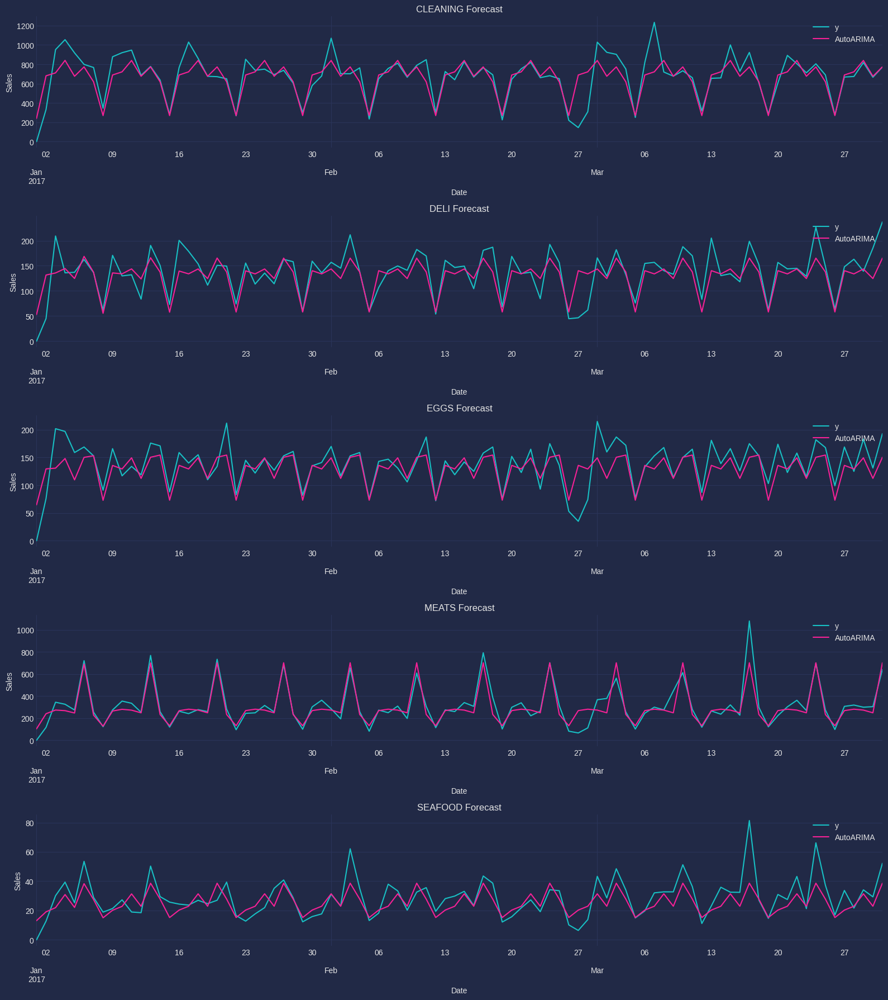

In [48]:
plot_forecasts(pred_arima)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [37]:
pred_total = pd.merge(pred_naive, pred_arima[['unique_id', 'ds', 'AutoARIMA']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,Naive,SeasWA,SeasonalNaive,WindowAverage
family,,,,,
CLEANING,13.349163,37.493661,14.353714,29.054684,32.844781
DELI,15.510463,26.073904,15.713238,27.614895,36.201118
EGGS,14.027082,22.446020,13.800009,31.703190,33.711617
MEATS,16.137121,50.838618,21.915593,30.236218,43.354514
SEAFOOD,23.496024,44.928126,26.269812,38.189091,41.384415


*Модель `ARIMA` показала улучшенное качество прогноза по метрике `WMAPE` по сравнению с предыдущим наивным прогнозом.*



---



## Scikit-learn


Создаем список с моделями `Scikit-learn`: `Random Forest` и `Extra Trees`, - затем создаем экземпляр класса `MLForecast`.
- `freq` - это частота данных. В нашем случае это ежедневные данные, поэтому мы устанавливаем для них значение `D`.
- `lags` - это список лагов (количество шагов в прошлом, которые мы хотим использовать для прогнозирования будущего). В нашем случае мы используем значение целевой переменной за `1`, `7` и `14` дней до даты временной метки наблюдения.
- `lag_transforms` - это словарь с лагами в качестве ключа и списком функций в качестве значения. Эти функции будут применены к запаздывающему ряду. Применим библиотеку `window_ops` и самописную функцию разности `diff` (с библиотекой `numba`).
- `date_features` - это список компонентов даты, которые мы хотим извлечь из столбца `date`. Нужен, чтобы помочь модели отразить сезонность данных.
- `num_threads` - это количество потоков, используемых для параллельной обработки.

Эту модель также обучим на признаке `onpromotion`.

In [ ]:
models = [RandomForestRegressor(random_state=42, n_estimators=100),
          ExtraTreesRegressor(random_state=42, n_estimators=100)]

model_skl = MLForecast(models=models,
                       freq='D',
                       lags=[1, 7, 14],
                       lag_transforms={1: [(rolling_mean, 7), (rolling_max, 7), (rolling_min, 7),
                                           (rolling_mean, 3), (rolling_mean, 14), (rolling_mean, 28),
                                           (diff, 1), (diff, 7)]},
                       date_features=['dayofweek', 'month'],
                       num_threads=4)
model_skl.fit(train, id_col='unique_id', time_col='ds', target_col='y', static_features=[])

pred_skl = model_skl.predict(horizon=h, dynamic_dfs=[valid[['ds', 'unique_id', 'onpromotion']]])
pred_skl = pred_skl.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')
pred_skl.head()

,unique_id,ds,RandomForestRegressor,ExtraTreesRegressor,y
0,CLEANING,2017-01-01,278.132810,228.560870,0.0
1,CLEANING,2017-01-02,743.559029,799.089156,332.0
2,CLEANING,2017-01-03,800.937610,739.015770,952.0
3,CLEANING,2017-01-04,807.880000,862.840000,1055.0
4,CLEANING,2017-01-05,708.250000,705.160000,918.0


Построим графики прогнозов моделей и истинных значений.

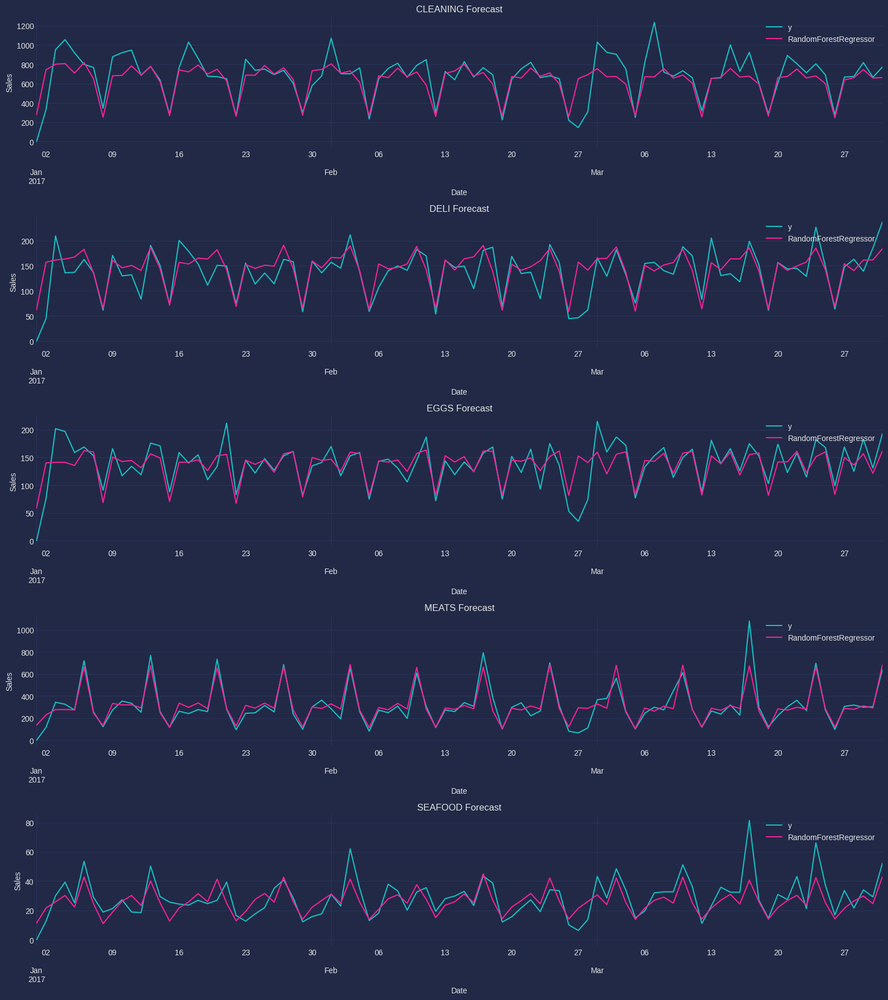

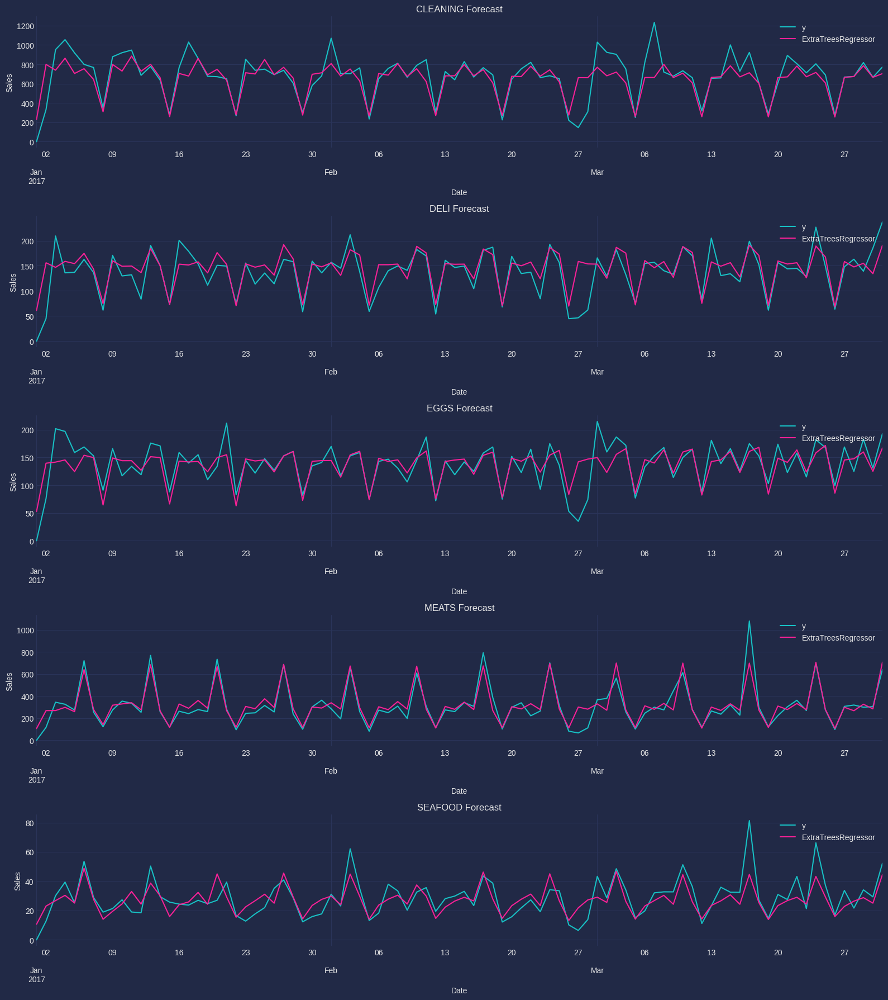

In [49]:
plot_forecasts(pred_skl)

Построим графики значимости признаков.

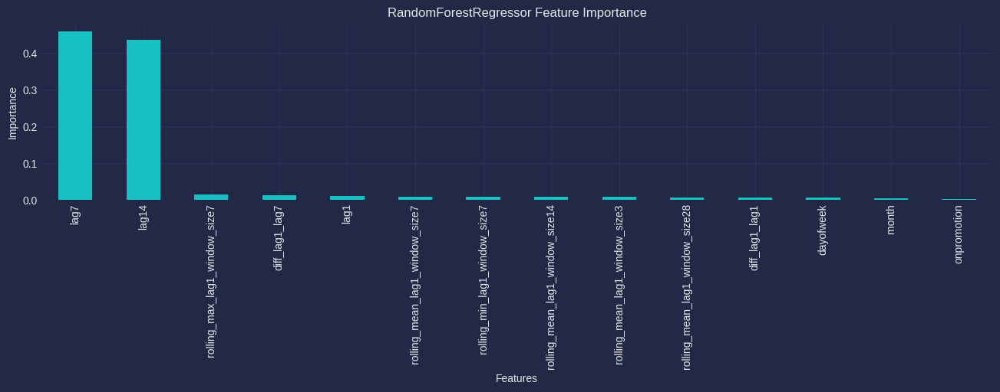

In [ ]:
pd.Series(model_skl.models_['RandomForestRegressor'].feature_importances_,
          index=model_skl.ts.features_order_).sort_values(ascending=False) \
          .plot.bar(figsize=(16, 3),
                    xlabel='Features',
                    ylabel='Importance',
                    title='RandomForestRegressor Feature Importance');

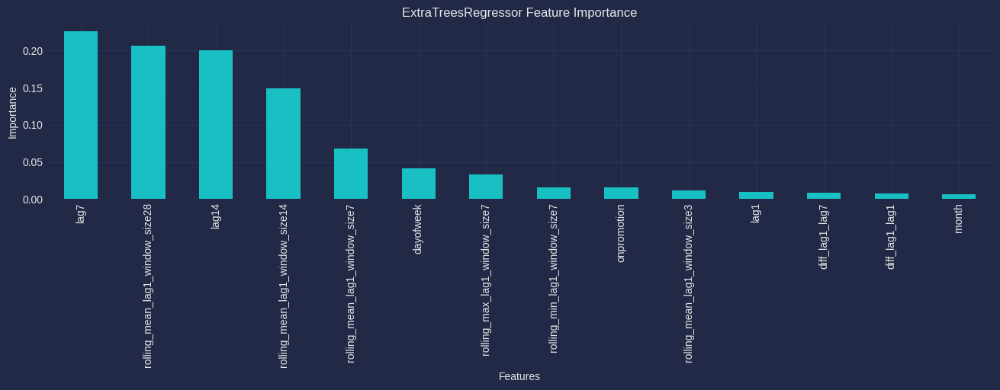

In [ ]:
pd.Series(model_skl.models_['ExtraTreesRegressor'].feature_importances_,
          index=model_skl.ts.features_order_).sort_values(ascending=False) \
          .plot.bar(figsize=(16, 3),
                    xlabel='Features',
                    ylabel='Importance',
                    title='ExtraTreesRegressor Feature Importance');

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [38]:
pred_total = pd.merge(pred_total, pred_skl[['unique_id', 'ds', 'RandomForestRegressor', 'ExtraTreesRegressor']],
                       on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,Naive,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage
family,,,,,,,
CLEANING,13.349163,13.729725,37.493661,14.966509,14.353714,29.054684,32.844781
DELI,15.510463,14.320664,26.073904,15.838575,15.713238,27.614895,36.201118
EGGS,14.027082,12.980869,22.446020,13.200668,13.800009,31.703190,33.711617
MEATS,16.137121,15.680925,50.838618,15.339613,21.915593,30.236218,43.354514
SEAFOOD,23.496024,22.268865,44.928126,23.468644,26.269812,38.189091,41.384415


*Модель `ExtraTreesRegressor` показала улучшенное качество прогноза по метрике `WMAPE` по сравнению с предыдущими прогнозоми.*



---



## LightGBM

Создаем список с одной моделью `LightGBM`, затем создаем экземпляр класса `MLForecast`.
- `freq` - это частота данных. В нашем случае это ежедневные данные, поэтому мы устанавливаем для них значение `D`.
- `lags` - это список лагов (количество шагов в прошлом, которые мы хотим использовать для прогнозирования будущего). В нашем случае мы используем значение целевой переменной за `1`, `7` и `14` дней до даты временной метки наблюдения.
- `lag_transforms` - это словарь с лагами в качестве ключа и списком функций в качестве значения. Эти функции будут применены к запаздывающему ряду. Применим библиотеку `window_ops` и самописную функцию разности `diff` (с библиотекой `numba`).
- `date_features` - это список компонентов даты, которые мы хотим извлечь из столбца `date`. Нужен, чтобы помочь модели отразить сезонность данных.
- `num_threads` - это количество потоков, используемых для параллельной обработки.

Эту модель также обучим на признаке `onpromotion`.

Применим библиотеку `Optuna` для настройки гиперпараметров `LightGBM`.

In [ ]:
def objective_lgbm(trial):
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-3, 1e-1)
    n_estimators = trial.suggest_int('n_estimators', 100, 600)
    num_leaves = trial.suggest_int('num_leaves', 2, 256)
    min_data_in_leaf = trial.suggest_int('min_data_in_leaf', 1, 100)
    bagging_fraction = trial.suggest_uniform('bagging_fraction', 0.1, 1.0)
    colsample_bytree = trial.suggest_uniform('colsample_bytree', 0.1, 1.0)
    lags = trial.suggest_int('lags', 14, 56, step=7)

    models = [LGBMRegressor(random_state=42,
                            verbosity=-1,
                            n_estimators=n_estimators,
                            bagging_freq=1,
                            learning_rate=learning_rate,
                            num_leaves=num_leaves,
                            min_data_in_leaf=min_data_in_leaf,
                            bagging_fraction=bagging_fraction,
                            colsample_bytree=colsample_bytree)]

    model = MLForecast(models=models,
                       freq='D',
                       lags=[1, 7, lags],
                       lag_transforms={1: [(rolling_mean, 7), (rolling_max, 7), (rolling_min, 7),
                                           (rolling_mean, 3), (rolling_mean, 14), (rolling_mean, 28),
                                           (diff, 1), (diff, 7)]},
                       date_features=['dayofweek', 'month'],
                       num_threads=6)
    model.fit(train, id_col='unique_id', time_col='ds', target_col='y', static_features=[])

    p = model.predict(horizon=h, dynamic_dfs=[valid[['ds', 'unique_id', 'onpromotion']]])
    p = p.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

    return wmape(p['y'], p['LGBMRegressor'])

In [ ]:
study = optuna.create_study(direction='minimize')
study.optimize(objective_lgbm, n_trials=20)

In [ ]:
print(f'{study.best_value:.2%}')
study.best_params

14.39%


{'learning_rate': 0.017088593493148167,
 'n_estimators': 418,
 'num_leaves': 57,
 'min_data_in_leaf': 33,
 'bagging_fraction': 0.3834282917408872,
 'colsample_bytree': 0.27021211904037834,
 'lags': 14}

Построим модель `LGBM` с подобранными гиперпараметрами.

In [ ]:
best_params = study.best_params

models = [LGBMRegressor(random_state=42,
                        verbosity=-1,
                        bagging_freq=1,
                        n_estimators=best_params['n_estimators'],
                        learning_rate=best_params['learning_rate'],
                        num_leaves=best_params['num_leaves'],
                        min_data_in_leaf=best_params['min_data_in_leaf'],
                        bagging_fraction=best_params['bagging_fraction'],
                        colsample_bytree=best_params['colsample_bytree'])]

model_lgbm = MLForecast(models=models,
                        freq='D',
                        lags=[1, 7, best_params['lags']],
                        lag_transforms={1: [(rolling_mean, 7), (rolling_max, 7), (rolling_min, 7),
                                            (rolling_mean, 3), (rolling_mean, 14), (rolling_mean, 28),
                                            (diff, 1), (diff, 7)]},
                        date_features=['dayofweek', 'month'],
                        num_threads=6)
model_lgbm.fit(train, id_col='unique_id', time_col='ds', target_col='y', static_features=[])

pred_lgbm = model_lgbm.predict(horizon=h, dynamic_dfs=[valid[['ds', 'unique_id', 'onpromotion']]])
pred_lgbm = pred_lgbm.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

Построим графики прогнозов моделей и истинных значений.

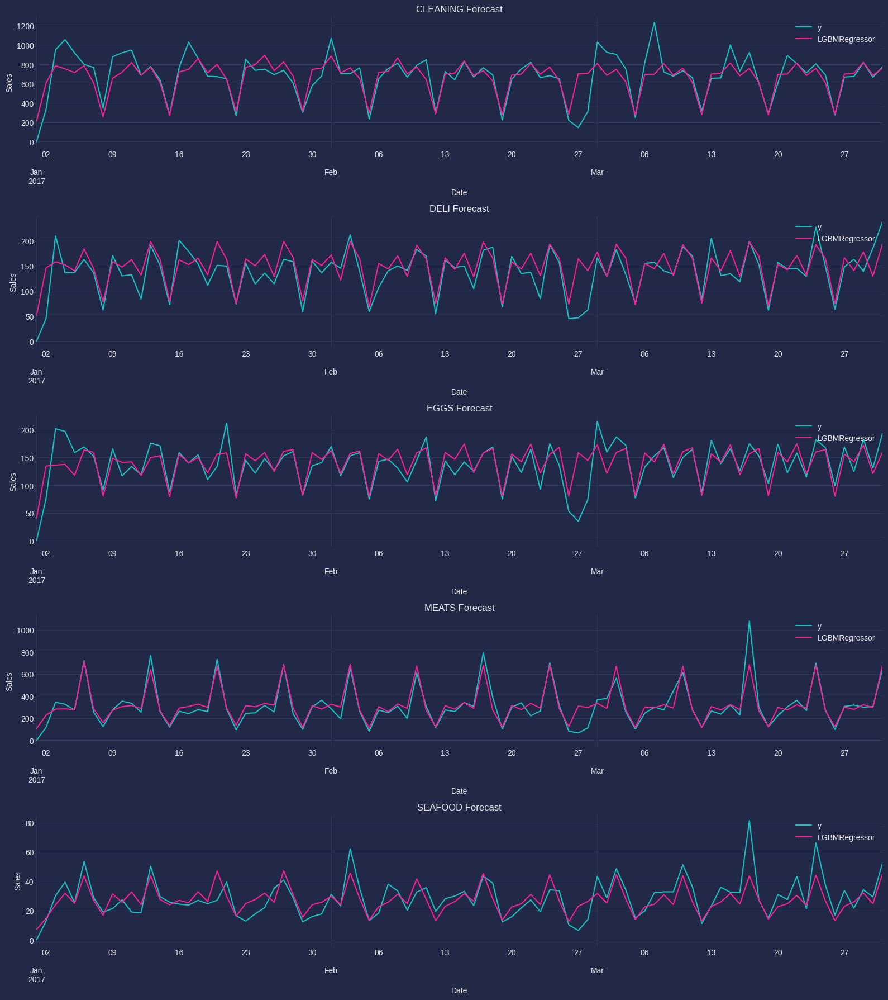

In [50]:
plot_forecasts(pred_lgbm)

Построим график значимости признаков.

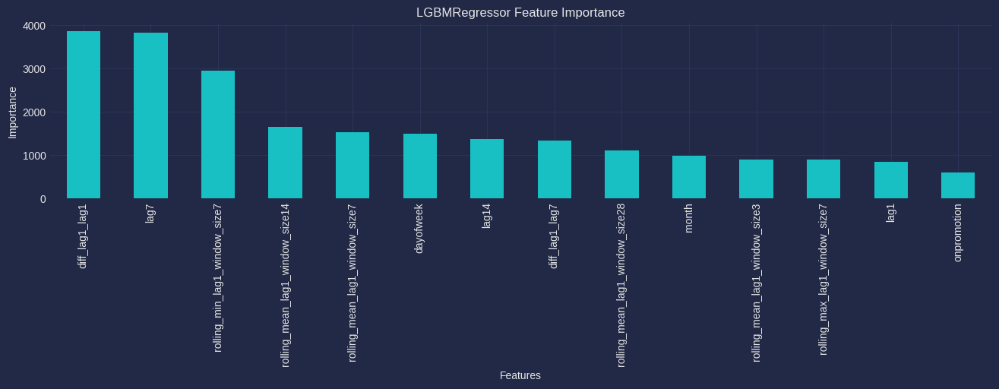

In [ ]:
pd.Series(model_lgbm.models_['LGBMRegressor'].feature_importances_,
          index=model_lgbm.ts.features_order_).sort_values(ascending=False) \
          .plot.bar(figsize=(16, 3),
                    xlabel='Features',
                    ylabel='Importance',
                    title='LGBMRegressor Feature Importance');

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('model_lgbm.pkl', 'wb') as output:
    pickle.dump(model_lgbm, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [40]:
pred_total = pd.merge(pred_total, pred_lgbm[['unique_id', 'ds', 'LGBMRegressor']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,LGBMRegressor,Naive,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage
family,,,,,,,,
CLEANING,13.349163,13.729725,13.724582,37.493661,14.966509,14.353714,29.054684,32.844781
DELI,15.510463,14.320664,15.583643,26.073904,15.838575,15.713238,27.614895,36.201118
EGGS,14.027082,12.980869,12.898348,22.446020,13.200668,13.800009,31.703190,33.711617
MEATS,16.137121,15.680925,15.265199,50.838618,15.339613,21.915593,30.236218,43.354514
SEAFOOD,23.496024,22.268865,22.148264,44.928126,23.468644,26.269812,38.189091,41.384415


*Модель `LGBMRegressor` показала улучшенное качество прогноза по метрике `WMAPE` по сравнению с предыдущими прогнозоми.*



---



## XGBoost

Создаем список с одной моделью `XGB`, затем создаем экземпляр класса `MLForecast`.
- `freq` - это частота данных. В нашем случае это ежедневные данные, поэтому мы устанавливаем для них значение `D`.
- `lags` - это список лагов (количество шагов в прошлом, которые мы хотим использовать для прогнозирования будущего). В нашем случае мы используем значение целевой переменной за `1`, `7` и `14` дней до даты временной метки наблюдения.
- `lag_transforms` - это словарь с лагами в качестве ключа и списком функций в качестве значения. Эти функции будут применены к запаздывающему ряду. Применим библиотеку `window_ops` и самописную функцию разности `diff` (с библиотекой `numba`).
- `date_features` - это список компонентов даты, которые мы хотим извлечь из столбца `date`. Нужен, чтобы помочь модели отразить сезонность данных.
- `num_threads` - это количество потоков, используемых для параллельной обработки.

Эту модель также обучим на признаке `onpromotion`.

Применим библиотеку `Optuna` для настройки гиперпараметров `XGB`.

In [ ]:
def objective_xgb(trial):
    n_estimators = trial.suggest_int('n_estimators', 100, 600)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-3, 1e-1)
    max_depth = trial.suggest_int('max_depth', 3, 10)
    min_child_weight = trial.suggest_int('min_child_weight', 1, 10)
    subsample = trial.suggest_uniform('subsample', 0.1, 1.0)
    colsample_bytree = trial.suggest_uniform('colsample_bytree', 0.1, 1.0)
    lags = trial.suggest_int('lags', 14, 56, step=7)

    models = [XGBRegressor(random_state=42,
                           n_estimators=n_estimators,
                           learning_rate=learning_rate,
                           max_depth=max_depth,
                           min_child_weight=min_child_weight,
                           subsample=subsample,
                           colsample_bytree=colsample_bytree)]

    model = MLForecast(models=models,
                       freq='D',
                       lags=[1, 7, lags],
                       lag_transforms={1: [(rolling_mean, 7), (rolling_max, 7), (rolling_min, 7),
                                           (rolling_mean, 3), (rolling_mean, 14), (rolling_mean, 28),
                                           (diff, 1), (diff, 7)]},
                       date_features=['dayofweek', 'month'],
                       num_threads=6)
    model.fit(train, id_col='unique_id', time_col='ds', target_col='y', static_features=[])

    p = model.predict(horizon=h, dynamic_dfs=[valid[['ds', 'unique_id', 'onpromotion']]])
    p = p.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

    return wmape(p['y'], p['XGBRegressor'])

In [ ]:
study = optuna.create_study(direction='minimize')
study.optimize(objective_xgb, n_trials=20)

[I 2023-10-20 13:52:33,048] A new study created in memory with name: no-name-4bb306e5-6cc0-45d3-8e9b-6311393c6224
[I 2023-10-20 13:52:36,606] Trial 0 finished with value: 0.21972799588759068 and parameters: {'n_estimators': 171, 'learning_rate': 0.014947565666678713, 'max_depth': 9, 'min_child_weight': 10, 'subsample': 0.8615655490118116, 'colsample_bytree': 0.6756821396720428, 'lags': 42}. Best is trial 0 with value: 0.21972799588759068.
[I 2023-10-20 13:52:40,102] Trial 1 finished with value: 0.18116671074673438 and parameters: {'n_estimators': 456, 'learning_rate': 0.06368445065692668, 'max_depth': 10, 'min_child_weight': 6, 'subsample': 0.2604378698244436, 'colsample_bytree': 0.8845244833742741, 'lags': 28}. Best is trial 1 with value: 0.18116671074673438.
[I 2023-10-20 13:52:42,015] Trial 2 finished with value: 0.7238836676828154 and parameters: {'n_estimators': 288, 'learning_rate': 0.0022270372574272296, 'max_depth': 6, 'min_child_weight': 9, 'subsample': 0.23845038311415706, 'c

In [ ]:
print(f'{study.best_value:.2%}')
study.best_params

14.82%


{'n_estimators': 540,
 'learning_rate': 0.026816375913094867,
 'max_depth': 8,
 'min_child_weight': 8,
 'subsample': 0.3006267228095725,
 'colsample_bytree': 0.7681303806178412,
 'lags': 14}

Построим модель `XGB` с подобранными гиперпараметрами.

In [ ]:
best_params = study.best_params

models = [XGBRegressor(random_state=42,
                       n_estimators=best_params['n_estimators'],
                       learning_rate=best_params['learning_rate'],
                       max_depth=best_params['max_depth'],
                       min_child_weight=best_params['min_child_weight'],
                       subsample=best_params['subsample'],
                       colsample_bytree=best_params['colsample_bytree'])]

model_xgb = MLForecast(models=models,
                       freq='D',
                       lags=[1, 7, best_params['lags']],
                       lag_transforms={1: [(rolling_mean, 7), (rolling_max, 7), (rolling_min, 7),
                                           (rolling_mean, 3), (rolling_mean, 14), (rolling_mean, 28),
                                           (diff, 1), (diff, 7)]},
                       date_features=['dayofweek', 'month'],
                       num_threads=6)
model_xgb.fit(train, id_col='unique_id', time_col='ds', target_col='y', static_features=[])

pred_xgb = model_xgb.predict(horizon=h, dynamic_dfs=[valid[['ds', 'unique_id', 'onpromotion']]])
pred_xgb = pred_xgb.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

Построим графики прогнозов моделей и истинных значений.

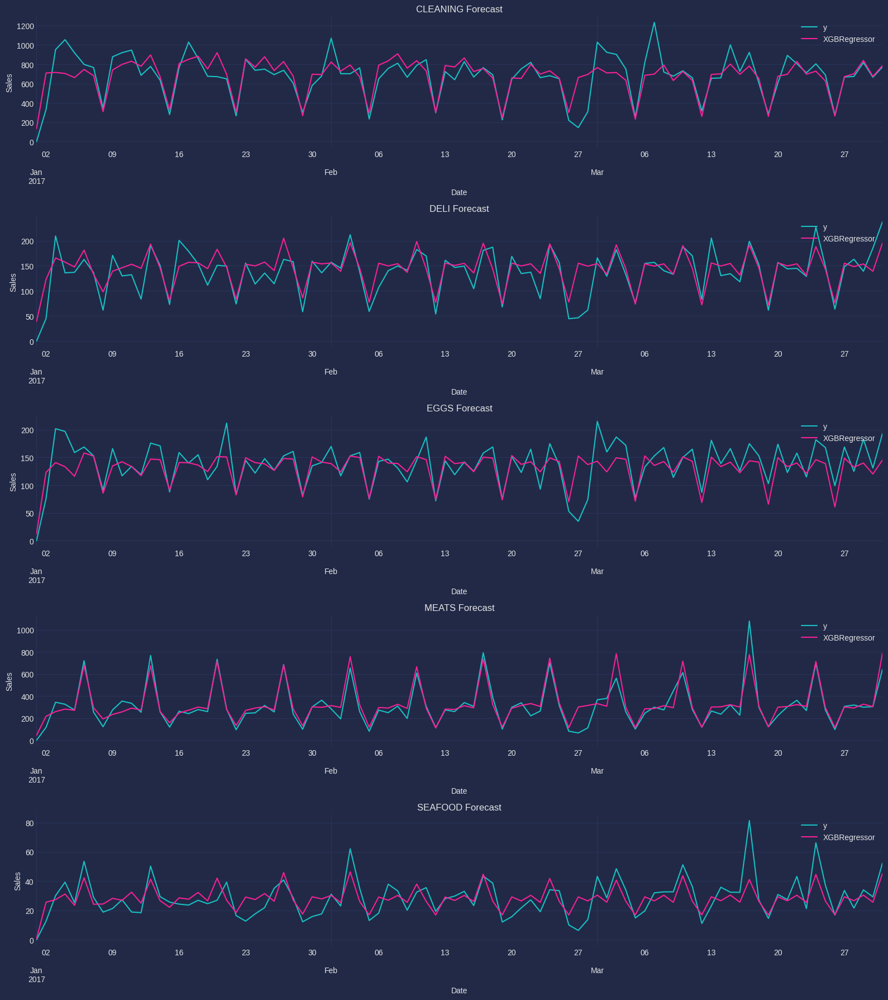

In [51]:
plot_forecasts(pred_xgb)

Построим график значимости признаков.

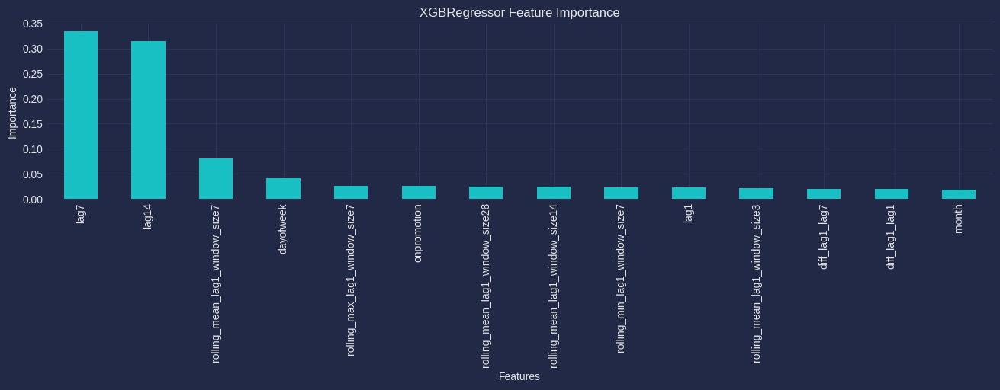

In [ ]:
pd.Series(model_xgb.models_['XGBRegressor'].feature_importances_,
          index=model_lgbm.ts.features_order_).sort_values(ascending=False) \
          .plot.bar(figsize=(16, 3),
                    xlabel='Features',
                    ylabel='Importance',
                    title='XGBRegressor Feature Importance');

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('model_xgb.pkl', 'wb') as output:
    pickle.dump(model_xgb, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [52]:
pred_total = pd.merge(pred_total, pred_xgb[['unique_id', 'ds', 'XGBRegressor']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,LGBMRegressor,Naive,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,
CLEANING,13.349163,13.729725,13.724582,37.493661,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,14.320664,15.583643,26.073904,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,12.980869,12.898348,22.446020,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.680925,15.265199,50.838618,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.268865,22.148264,44.928126,23.468644,26.269812,38.189091,41.384415,24.472920


*Модель `XGBRegressor` улучшила качество прогноза по метрике `WMAPE` по сравнению с предыдущими прогнозоми только по семейству товаров `MEATS`.*



---



## Prophet

Обучим модель `Prophet` для каждого временного ряда, который мы хотим спрогнозировать.

Загрузим данные о праздничных днях в Эквадоре, и `Prophet` может использовать их, чтобы зафиксировать конкретные закономерности, связанные с этими днями.

Оставим только дни национальных праздников.

In [ ]:
holidays_df = pd.read_csv('/content/sales-ts-forecast/holidays_events.csv')
holidays_df = holidays_df.loc[holidays_df['locale'] == 'National', ['date', 'description']]
holidays_df['lower_window'] = 0
holidays_df['upper_window'] = 1
holidays_df = holidays_df.rename(columns={'date': 'ds', 'description': 'holiday'})

Создадим функцию для распараллеливания обучения, прогнозирования и сохранения модели `Prophet` с помощью библиотеки `joblib`.

Эта функция принимает набор данных для обучения и проверки для одного семейства и возвращает фрейм данных с прогнозом. Третий аргумент - это название семейства.

Параметры:
- `seasonality_mode` - сезонная составляющая модели. Установим значение `additive` - аддитивная сезонность,
- `yearly_seasonality` - сезонность в течение всего года,
- `weekly_seasonality` - сезонность в течение недели,
- `daily_seasonality` - сезонность в течение дня. В нашем случае - отсутствует,
- `holidays` - данные о праздничных днях. Применим фрейм данных `holidays_df` с информацией о праздниках в Эквадоре,
- `add_regressor` - функция  для добавления столбца `onpromotion` в модель.

In [ ]:
def run_one(train_, valid_, family):
    print('family:', family)
    m = Prophet(seasonality_mode='additive',
                yearly_seasonality=True,
                weekly_seasonality=True,
                daily_seasonality=False,
                holidays=holidays_df)
    m.add_regressor('onpromotion')
    m.fit(train_)

    # Сохраняем модель Prophet
    with open(f'prophet_{family}.json', 'w') as f:
        f.write(model_to_json(m))

    future = m.make_future_dataframe(periods=h, include_history=False)
    future = future.merge(valid_[['ds', 'onpromotion']], on='ds', how='left')

    forecast = m.predict(future)
    forecast['unique_id'] = family

    return forecast[['ds', 'yhat', 'unique_id']]

Далее создаем список заданий для параллельного выполнения.

Готовим обучающие и проверочные наборы для каждой семейства товаров.

Затем мы используем отложенную функцию из библиотеки `joblib`, чтобы создать задание для каждой семейства.

Мы передаем функцию `run_one` в качестве аргумента, а затем передаем аргументы функции во вторые круглые скобки.

In [ ]:
jobs = list()

for family in train['unique_id'].unique():
    train_ = train.loc[train['unique_id'] == family]
    valid_ = valid.loc[valid['unique_id'] == family]
    jobs.append(delayed(run_one)(train_, valid_, family))

pred_prophet = Parallel(n_jobs=4)(jobs)
pred_prophet = pd.concat(pred_prophet, ignore_index=True)
pred_prophet['yhat'] = pred_prophet['yhat'].clip(lower=0)
pred_prophet = pred_prophet.merge(valid, on=['ds', 'unique_id'], how='left').sort_values('ds')
pred_prophet = pred_prophet.rename(columns={'yhat': 'Prophet'})

Построим графики прогнозов моделей и истинных значений.

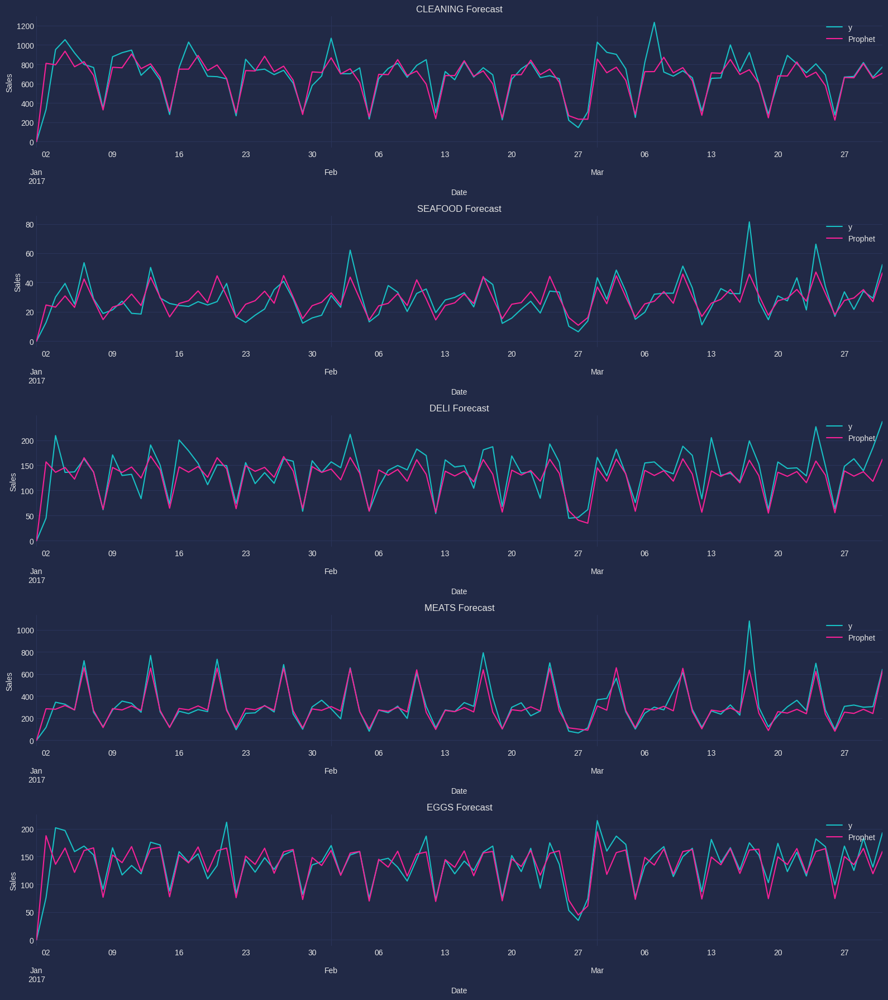

In [53]:
plot_forecasts(pred_prophet)

Загрузим сохраненную модель `Prophet`.

In [ ]:
with open(f'prophet_{family}.json', 'r') as f:
    model_prophet = model_from_json(f.read())
model_prophet

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('model_prophet.pkl', 'wb') as output:
    pickle.dump(model_prophet, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [54]:
pred_total = pd.merge(pred_total, pred_prophet[['unique_id', 'ds', 'Prophet']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,LGBMRegressor,Naive,Prophet,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,,
CLEANING,13.349163,13.729725,13.724582,37.493661,11.554434,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,14.320664,15.583643,26.073904,14.800930,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,12.980869,12.898348,22.446020,10.763817,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.680925,15.265199,50.838618,13.861129,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.268865,22.148264,44.928126,20.399288,23.468644,26.269812,38.189091,41.384415,24.472920


*Модель `Prophet` показывает наилучшее качество прогноза по сравнению с предыдущими моделями по всем семействам товаров кроме `DELI`.*



---



## GRU (Gated Recurrent Units)
gpu

Для создания модели `GRU` мы будем использовать библиотеку `NeuralForecast`.

Поскольку `NeuralForecast` использует методы глубокого обучения, если у вас есть графический процессор, важно установить `CUDA`, чтобы модели работали быстрее.

Проверим, установлен ли у вас графический процессор `GPU` и правильно ли он настроен с помощью `PyTorch` (серверная библиотека).

In [ ]:
torch.cuda.is_available()

True

Создадим экземпляры классов `NeuralForecast` (служебный класс для управления внутренними процессами обучения нейронной сети) и `GRU` (класс для реализации архитектуры) для обучения сети.

Гиперпараметры:
- `h` - горизонт - количество шагов в будущее, которое мы хотим предсказать,
- `loss` - функция потерь, которая будет использоваться для оптимизации весов сети. Будем использовать `DistributionLoss`,
- `futr_exog_list` - список имен внешних переменных, которые мы хотим использовать в прогнозе,
- `context_size` - количество шагов в прошлом, используемое для прогнозирования следующего шага. В нашем случае это ежедневные данные, поэтому он будет использовать последние 10 дней для прогнозирования следующего,
- `encoder_hidden_size` - количество единиц (нейронов) внутреннего представления кодера (скрытого слоя),
- `encoder_n_layers` - количество слоев в кодере,
- `encoder_dropout` - частота отсева кодера. Отсев - метод регуляризации, который помогает предотвратить переобучение путем обнуления случайного процента единиц в каждом слое во время обучения,
- `decoder_hidden_size` - количество единиц (нейронов) внутренних представлений декодера. Декодер представляет собой обычную нейронную сеть с прямой связью (MLP),
- `decoder_layers` - количество слоев в MLP-декодере,
- `scaler_type` - тип масштабирования данных (`None`: отсутствие масштабирования, `standard`: стандартизированное масштабирование, `robust`: робастное масштабирование),
- `learning_rate` - размер шага, используемого алгоритмом оптимизации для обновления весов сети,
- `max_steps` - максимальное количество шагов обучения.

Применим библиотеку `Optuna` для настройки гиперпараметров `GRU`.

In [ ]:
def objective_gru(trial):
    encoder_n_layers = trial.suggest_int('encoder_n_layers', 1, 3)
    encoder_hidden_size = trial.suggest_categorical('encoder_hidden_size', [64, 128, 256])
    decoder_layers = trial.suggest_int('decoder_layers', 1, 3)
    encoder_dropout = trial.suggest_uniform('encoder_dropout', 0, 0.9)
    decoder_hidden_size = trial.suggest_categorical('decoder_hidden_size', [64, 128, 256])
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
    context_size = trial.suggest_int('context_size', 1, 60)
    scaler_type = trial.suggest_categorical('scaler_type', ['standard', 'robust'])

    models = [GRU(h=h,
                  loss=DistributionLoss(distribution='Normal', level=[90]),
                  max_steps=100,
                  futr_exog_list=['onpromotion'],
                  encoder_n_layers=encoder_n_layers,
                  encoder_hidden_size=encoder_hidden_size,
                  context_size=context_size,
                  encoder_dropout=encoder_dropout,
                  decoder_hidden_size=decoder_hidden_size,
                  decoder_layers=decoder_layers,
                  learning_rate=learning_rate,
                  scaler_type=scaler_type)]

    model = NeuralForecast(models=models, freq='D')
    model.fit(train)

    p = model.predict(futr_df=valid).reset_index()
    p = p.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

    return wmape(p['y'], p['GRU'])

In [ ]:
study = optuna.create_study(direction='minimize')
study.optimize(objective_gru, n_trials=20)

[I 2023-10-21 20:11:29,673] A new study created in memory with name: no-name-5c0ecb59-898a-4610-a9ac-c7634b197ddc
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:11:45,409] Trial 0 finished with value: 0.23159535568785 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 64, 'decoder_layers': 2, 'encoder_dropout': 0.6363089745224659, 'decoder_hidden_size': 256, 'learning_rate': 0.018140214385596622, 'context_size': 46, 'scaler_type': 'robust'}. Best is trial 0 with value: 0.23159535568785.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:11:59,092] Trial 1 finished with value: 0.20418464400127478 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 256, 'decoder_layers': 1, 'encoder_dropout': 0.29987850282590106, 'decoder_hidden_size': 128, 'learning_rate': 0.024407290838188062, 'context_size': 34, 'scaler_type': 'standard'}. Best is trial 1 with value: 0.20418464400127478.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:12:06,839] Trial 2 finished with value: 0.18415242337877316 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 64, 'decoder_layers': 1, 'encoder_dropout': 0.24068158386131042, 'decoder_hidden_size': 256, 'learning_rate': 0.010007620834874468, 'context_size': 7, 'scaler_type': 'standard'}. Best is trial 2 with value: 0.18415242337877316.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:12:16,208] Trial 3 finished with value: 0.2864166470061549 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 1, 'encoder_dropout': 0.24669307856393938, 'decoder_hidden_size': 256, 'learning_rate': 0.054748072209599145, 'context_size': 53, 'scaler_type': 'robust'}. Best is trial 2 with value: 0.18415242337877316.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:12:24,258] Trial 4 finished with value: 0.16082405741338843 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 1, 'encoder_dropout': 0.8454677948390863, 'decoder_hidden_size': 256, 'learning_rate': 0.00581387329679647, 'context_size': 22, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:12:31,512] Trial 5 finished with value: 0.30245524714316263 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 128, 'decoder_layers': 2, 'encoder_dropout': 0.6596233719699282, 'decoder_hidden_size': 128, 'learning_rate': 1.761789673888956e-05, 'context_size': 28, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:12:51,347] Trial 6 finished with value: 0.28803992936131506 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 1, 'encoder_dropout': 0.5880600570524178, 'decoder_hidden_size': 128, 'learning_rate': 0.02246425492148308, 'context_size': 55, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:07,541] Trial 7 finished with value: 0.27391558101194097 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'encoder_dropout': 0.5409324292233135, 'decoder_hidden_size': 256, 'learning_rate': 1.1724363291349386e-05, 'context_size': 9, 'scaler_type': 'robust'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:14,680] Trial 8 finished with value: 0.30330642465878016 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 64, 'decoder_layers': 2, 'encoder_dropout': 0.05017403612043381, 'decoder_hidden_size': 256, 'learning_rate': 6.117077070826137e-05, 'context_size': 2, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:27,533] Trial 9 finished with value: 0.27627952897166835 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 256, 'decoder_layers': 2, 'encoder_dropout': 0.0694881100386404, 'decoder_hidden_size': 256, 'learning_rate': 1.638272381858672e-05, 'context_size': 27, 'scaler_type': 'robust'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:33,750] Trial 10 finished with value: 0.16770859582414302 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'encoder_dropout': 0.8582937707599876, 'decoder_hidden_size': 64, 'learning_rate': 0.001939629703087984, 'context_size': 18, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:39,955] Trial 11 finished with value: 0.1730992851868397 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'encoder_dropout': 0.8926160097248186, 'decoder_hidden_size': 64, 'learning_rate': 0.0014962348044376625, 'context_size': 18, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:46,582] Trial 12 finished with value: 0.1714461473956466 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'encoder_dropout': 0.8901932928280551, 'decoder_hidden_size': 64, 'learning_rate': 0.001874211489400176, 'context_size': 19, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:53,869] Trial 13 finished with value: 0.1815163277083878 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'encoder_dropout': 0.775016533636534, 'decoder_hidden_size': 64, 'learning_rate': 0.004823138721345917, 'context_size': 38, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:13:59,291] Trial 14 finished with value: 0.2002382877547625 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 128, 'decoder_layers': 2, 'encoder_dropout': 0.786510125154279, 'decoder_hidden_size': 64, 'learning_rate': 0.000414661929962798, 'context_size': 18, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:14:05,609] Trial 15 finished with value: 0.2041773454417818 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'encoder_dropout': 0.7454146600125067, 'decoder_hidden_size': 64, 'learning_rate': 0.00037726446319478096, 'context_size': 24, 'scaler_type': 'standard'}. Best is trial 4 with value: 0.16082405741338843.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:14:11,159] Trial 16 finished with value: 0.1462786764605388 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 128, 'decoder_layers': 1, 'encoder_dropout': 0.48092555136723436, 'decoder_hidden_size': 64, 'learning_rate': 0.005705339864711798, 'context_size': 13, 'scaler_type': 'standard'}. Best is trial 16 with value: 0.1462786764605388.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:14:19,711] Trial 17 finished with value: 784.1392220281759 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 128, 'decoder_layers': 1, 'encoder_dropout': 0.4727654488585792, 'decoder_hidden_size': 256, 'learning_rate': 0.09441463846346113, 'context_size': 8, 'scaler_type': 'standard'}. Best is trial 16 with value: 0.1462786764605388.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:14:36,127] Trial 18 finished with value: 0.20470780352544446 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 1, 'encoder_dropout': 0.4118845654077374, 'decoder_hidden_size': 64, 'learning_rate': 0.00511460461252479, 'context_size': 13, 'scaler_type': 'robust'}. Best is trial 16 with value: 0.1462786764605388.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:14:43,128] Trial 19 finished with value: 0.20313913401948794 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 64, 'decoder_layers': 1, 'encoder_dropout': 0.6822933061469284, 'decoder_hidden_size': 128, 'learning_rate': 0.0005325929235428237, 'context_size': 40, 'scaler_type': 'standard'}. Best is trial 16 with value: 0.1462786764605388.


In [ ]:
print(f'{study.best_value:.2%}')
study.best_params

14.63%


{'encoder_n_layers': 2,
 'encoder_hidden_size': 128,
 'decoder_layers': 1,
 'encoder_dropout': 0.48092555136723436,
 'decoder_hidden_size': 64,
 'learning_rate': 0.005705339864711798,
 'context_size': 13,
 'scaler_type': 'standard'}

Построим модель `GRU` с подобранными гиперпараметрами.

In [ ]:
best_params = study.best_params

encoder_n_layers = best_params['encoder_n_layers']
encoder_hidden_size = best_params['encoder_hidden_size']
decoder_layers = best_params['decoder_layers']
encoder_dropout = best_params['encoder_dropout']
decoder_hidden_size = best_params['decoder_hidden_size']
learning_rate = best_params['learning_rate']
context_size = best_params['context_size']
scaler_type = best_params['scaler_type']

models = [GRU(h=h,
              loss=DistributionLoss(distribution='Normal', level=[90]),
              max_steps=100,
              futr_exog_list=['onpromotion'],
              encoder_n_layers=encoder_n_layers,
              encoder_hidden_size=encoder_hidden_size,
              context_size=context_size,
              encoder_dropout=encoder_dropout,
              decoder_hidden_size=decoder_hidden_size,
              decoder_layers=decoder_layers,
              learning_rate=learning_rate,
              scaler_type=scaler_type)]

model_gru = NeuralForecast(models=models, freq='D')
model_gru.fit(train)

pred_gru =  model_gru.predict(futr_df=valid).reset_index()
pred_gru = pred_gru.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

Построим графики прогнозов моделей и истинных значений.

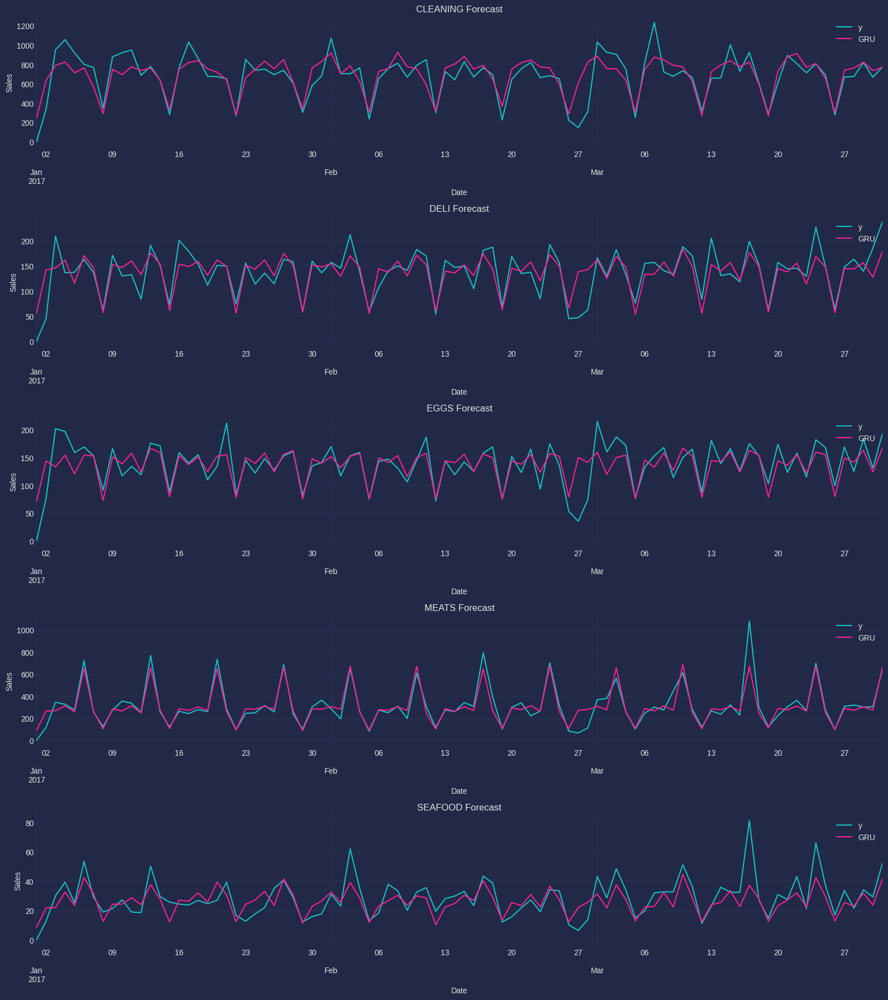

In [55]:
plot_forecasts(pred_gru[['ds', 'unique_id', 'y', 'GRU']])

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('model_gru.pkl', 'wb') as output:
    pickle.dump(model_gru, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [56]:
pred_total = pd.merge(pred_total, pred_gru[['unique_id', 'ds', 'GRU']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,GRU,LGBMRegressor,Naive,Prophet,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,,,
CLEANING,13.349163,13.729725,14.648318,13.724582,37.493661,11.554434,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,14.320664,14.851767,15.583643,26.073904,14.800930,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,12.980869,12.857864,12.898348,22.446020,10.763817,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.680925,14.489933,15.265199,50.838618,13.861129,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.268865,23.096465,22.148264,44.928126,20.399288,23.468644,26.269812,38.189091,41.384415,24.472920


*Модель `GRU` не смогла улучшить качество прогноза по сравнению с предыдущими моделями.*



---



## LSTM
gpu

Для создания модели `LSTM` мы будем использовать библиотеку `NeuralForecast`.

Поскольку `NeuralForecast` использует методы глубокого обучения, если у вас есть графический процессор, важно установить `CUDA`, чтобы модели работали быстрее.

Проверим, установлен ли у вас графический процессор `GPU` и правильно ли он настроен с помощью `PyTorch` (серверная библиотека).

In [ ]:
torch.cuda.is_available()

True

Создадим экземпляры классов `NeuralForecast` (служебный класс для управления внутренними процессами обучения нейронной сети) и `LSTM` (класс для реализации архитектуры) для обучения сети.

Гиперпараметры:
- `h` - горизонт - количество шагов в будущее, которое мы хотим предсказать,
- `loss` - функция потерь, которая будет использоваться для оптимизации весов сети. Будем использовать `DistributionLoss`,
- `futr_exog_list` - список имен внешних переменных, которые мы хотим использовать в прогнозе,
- `context_size` - количество шагов в прошлом, используемое для прогнозирования следующего шага. В нашем случае это ежедневные данные, поэтому он будет использовать последние 10 дней для прогнозирования следующего,
- `encoder_hidden_size` - количество единиц (нейронов) внутреннего представления кодера (скрытого слоя),
- `encoder_n_layers` - количество слоев в кодере,
- `decoder_hidden_size` - количество единиц (нейронов) внутренних представлений декодера. Декодер представляет собой обычную нейронную сеть с прямой связью (MLP),
- `decoder_layers` - количество слоев в MLP-декодере,
- `scaler_type` - тип масштабирования данных (`None`: отсутствие масштабирования, `standard`: стандартизированное масштабирование, `robust`: робастное масштабирование),
- `learning_rate` - размер шага, используемого алгоритмом оптимизации для обновления весов сети,
- `max_steps` - максимальное количество шагов обучения.

Применим библиотеку `Optuna` для настройки гиперпараметров `LSTM`.

In [ ]:
def objective_lstm(trial):
    encoder_n_layers = trial.suggest_int('encoder_n_layers', 1, 3)
    encoder_hidden_size = trial.suggest_categorical('encoder_hidden_size', [64, 128, 256])
    decoder_layers = trial.suggest_int('decoder_layers', 1, 3)
    decoder_hidden_size = trial.suggest_categorical('decoder_hidden_size', [64, 128, 256])
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
    context_size = trial.suggest_int('context_size', 1, 60)
    scaler_type = trial.suggest_categorical('scaler_type', ['standard', 'robust'])

    models = [LSTM(h=h,
                   loss=DistributionLoss(distribution='Poisson', level=[90]), #Normal
                   max_steps=100,
                   futr_exog_list=['onpromotion'],
                   encoder_n_layers=encoder_n_layers,
                   encoder_hidden_size=encoder_hidden_size,
                   context_size=context_size,
                   decoder_hidden_size=decoder_hidden_size,
                   decoder_layers=decoder_layers,
                   learning_rate=learning_rate)]

    model = NeuralForecast(models=models, freq='D')
    model.fit(train)

    p = model.predict(futr_df=valid).reset_index()
    p = p.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

    return wmape(p['y'], p['LSTM'])

In [ ]:
study = optuna.create_study(direction='minimize')
study.optimize(objective_lstm, n_trials=20)

[I 2023-10-21 20:57:57,611] A new study created in memory with name: no-name-d6cec787-8094-4609-985e-0af7bf478bca
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:58:08,230] Trial 0 finished with value: 0.19461760290547003 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 64, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.0004006038845851264, 'context_size': 57, 'scaler_type': 'robust'}. Best is trial 0 with value: 0.19461760290547003.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:58:16,655] Trial 1 finished with value: 1.0 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 64, 'decoder_layers': 2, 'decoder_hidden_size': 256, 'learning_rate': 0.07543150981391639, 'context_size': 49, 'scaler_type': 'standard'}. Best is trial 0 with value: 0.19461760290547003.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:58:32,715] Trial 2 finished with value: 0.2751179148550903 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 256, 'decoder_layers': 1, 'decoder_hidden_size': 256, 'learning_rate': 1.843930782068856e-05, 'context_size': 60, 'scaler_type': 'standard'}. Best is trial 0 with value: 0.19461760290547003.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:58:54,981] Trial 3 finished with value: 0.17208160865671468 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.0018636889275400767, 'context_size': 60, 'scaler_type': 'robust'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:59:04,156] Trial 4 finished with value: 0.3123187186867663 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 64, 'decoder_layers': 2, 'decoder_hidden_size': 256, 'learning_rate': 0.08559147616688115, 'context_size': 47, 'scaler_type': 'standard'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:59:12,644] Trial 5 finished with value: 0.2124866664628799 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 128, 'decoder_layers': 2, 'decoder_hidden_size': 64, 'learning_rate': 0.00862082799225302, 'context_size': 52, 'scaler_type': 'standard'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:59:19,330] Trial 6 finished with value: 0.27371830619231524 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 1, 'decoder_hidden_size': 64, 'learning_rate': 0.00023021591221568497, 'context_size': 15, 'scaler_type': 'robust'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:59:27,356] Trial 7 finished with value: 0.23330185537621181 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 128, 'decoder_layers': 2, 'decoder_hidden_size': 128, 'learning_rate': 0.00017412281315803206, 'context_size': 12, 'scaler_type': 'robust'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 20:59:45,482] Trial 8 finished with value: 0.1999216335422574 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 1, 'decoder_hidden_size': 64, 'learning_rate': 0.00022201469428688014, 'context_size': 43, 'scaler_type': 'standard'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:00:05,313] Trial 9 finished with value: 0.2805685097185161 and parameters: {'encoder_n_layers': 1, 'encoder_hidden_size': 128, 'decoder_layers': 3, 'decoder_hidden_size': 256, 'learning_rate': 1.67463869451421e-05, 'context_size': 57, 'scaler_type': 'robust'}. Best is trial 3 with value: 0.17208160865671468.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:00:26,205] Trial 10 finished with value: 0.1710036997519465 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.0015854976246927688, 'context_size': 32, 'scaler_type': 'robust'}. Best is trial 10 with value: 0.1710036997519465.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:00:47,402] Trial 11 finished with value: 0.1952386253681776 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.0019363533399997703, 'context_size': 30, 'scaler_type': 'robust'}. Best is trial 10 with value: 0.1710036997519465.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:01:08,550] Trial 12 finished with value: 0.16599336533407025 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.0018922358847174021, 'context_size': 32, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:01:29,286] Trial 13 finished with value: 0.20677593606283645 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.00781691122617246, 'context_size': 30, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:01:49,412] Trial 14 finished with value: 0.22488487062796214 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.005244892801227801, 'context_size': 22, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:02:08,974] Trial 15 finished with value: 0.19742046583960202 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.0007830765752031019, 'context_size': 2, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:02:27,561] Trial 16 finished with value: 0.2611547529274171 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 2, 'decoder_hidden_size': 128, 'learning_rate': 0.01776911358381811, 'context_size': 39, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:02:45,502] Trial 17 finished with value: 0.21583783255994407 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 256, 'decoder_layers': 3, 'decoder_hidden_size': 128, 'learning_rate': 0.001405119425714801, 'context_size': 38, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:03:03,686] Trial 18 finished with value: 0.19993528386969237 and parameters: {'encoder_n_layers': 3, 'encoder_hidden_size': 256, 'decoder_layers': 2, 'decoder_hidden_size': 128, 'learning_rate': 0.0033443480809137865, 'context_size': 23, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:03:11,445] Trial 19 finished with value: 0.190551472946906 and parameters: {'encoder_n_layers': 2, 'encoder_hidden_size': 64, 'decoder_layers': 3, 'decoder_hidden_size': 64, 'learning_rate': 0.0006716250884595326, 'context_size': 37, 'scaler_type': 'robust'}. Best is trial 12 with value: 0.16599336533407025.


In [ ]:
print(f'{study.best_value:.2%}')
study.best_params

16.60%


{'encoder_n_layers': 3,
 'encoder_hidden_size': 256,
 'decoder_layers': 3,
 'decoder_hidden_size': 128,
 'learning_rate': 0.0018922358847174021,
 'context_size': 32,
 'scaler_type': 'robust'}

Построим модель `LSTM` с подобранными гиперпараметрами.

In [ ]:
best_params = study.best_params

encoder_n_layers = best_params['encoder_n_layers']
encoder_hidden_size = best_params['encoder_hidden_size']
decoder_layers = best_params['decoder_layers']
decoder_hidden_size = best_params['decoder_hidden_size']
learning_rate = best_params['learning_rate']
context_size = best_params['context_size']
scaler_type = best_params['scaler_type']

models = [LSTM(h=h,
               loss=DistributionLoss(distribution='Poisson', level=[90]),
               max_steps=100,
               futr_exog_list=['onpromotion'],
               encoder_n_layers=encoder_n_layers,
               encoder_hidden_size=encoder_hidden_size,
               context_size=context_size,
               decoder_hidden_size=decoder_hidden_size,
               decoder_layers=decoder_layers,
               learning_rate=learning_rate)]

model_lstm = NeuralForecast(models=models, freq='D')
model_lstm.fit(train)

pred_lstm = model_lstm.predict(futr_df=valid).reset_index()
pred_lstm = pred_lstm.merge(valid[['ds','unique_id', 'y']], on=['ds', 'unique_id'], how='left')

INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

Построим графики прогнозов моделей и истинных значений.

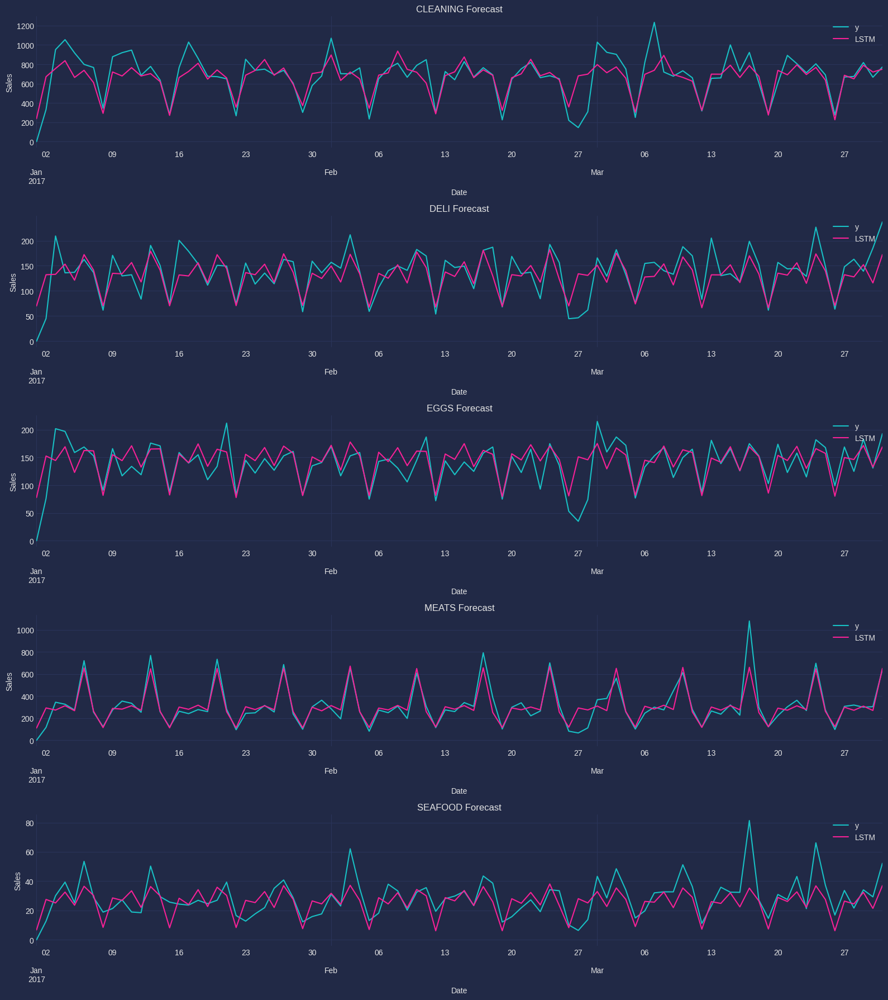

In [57]:
plot_forecasts(pred_lstm[['ds', 'unique_id', 'y', 'LSTM']])

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('model_lstm.pkl', 'wb') as output:
    pickle.dump(model_lstm, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [58]:
pred_total = pd.merge(pred_total, pred_lstm[['unique_id', 'ds', 'LSTM']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,GRU,LGBMRegressor,LSTM,Naive,Prophet,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,,,,
CLEANING,13.349163,13.729725,14.648318,13.724582,14.542956,37.493661,11.554434,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,14.320664,14.851767,15.583643,16.278342,26.073904,14.800930,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,12.980869,12.857864,12.898348,13.643039,22.446020,10.763817,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.680925,14.489933,15.265199,15.104359,50.838618,13.861129,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.268865,23.096465,22.148264,26.972779,44.928126,20.399288,23.468644,26.269812,38.189091,41.384415,24.472920


*Модель `LSTM` не смогла улучшить качество прогноза по сравнению с предыдущими моделями.*



---



## N-BEATS
gpu

Для создания модели `N-BEATS` мы будем использовать библиотеку `NeuralForecast`.

Поскольку `NeuralForecast` использует методы глубокого обучения, если у вас есть графический процессор, важно установить `CUDA`, чтобы модели работали быстрее.

Проверим, установлен ли у вас графический процессор `GPU` и правильно ли он настроен с помощью `PyTorch` (серверная библиотека).

In [ ]:
torch.cuda.is_available()

True

Создадим экземпляры классов `NeuralForecast` (служебный класс для управления внутренними процессами обучения нейронной сети) и `N-BEATS` (класс для реализации архитектуры) для обучения сети.

Гиперпараметры:
- `h` - горизонт - количество шагов в будущее, которое мы хотим предсказать,
- `loss` - функция потерь, которая будет использоваться для оптимизации весов сети. Будем использовать `DistributionLoss`,
- `futr_exog_list` - список имен внешних переменных, которые мы хотим использовать в прогнозе,
- `input_size` - количество прошедших временных шагов, которые модель будет использовать для прогнозирования следующих `h` шагов,
- `input_size` - количество входных данных авторегрессии (лагов), учитываемых моделью?
- `n_blocks_*` - 3 целых значения (`n_blocks_season`, `n_blocks_trend` и `n_blocks_identity`), которые соответствуют количеству блоков для каждого типа стека (сезонность, тренд и идентичность) в модели `N-BEATS`?
- `mlp_units_n` - количество скрытых слоев в многослойном персептроне (MLP), который используется для прогнозирования следующего значения временного ряда,
- `num_hidden` - количество скрытых нейронов в каждом слое MLP (многослойного перцептрона), который используется для предсказания следующего значения временного ряда,
- `mlp_units` - количество нейронов в каждом скрытом слое MLP, используемом для прогнозирования следующего значения временного ряда,
- `n_harmonics` - количество гармоник, используемых для моделирования сезонности,
- `n_polynomials` - количество полиномов, используемых для аппроксимации тренда,
- `scaler_type` - тип масштабирования данных (`standard`: стандартизированное масштабирование, `robust`: робастное масштабирование),
- `learning_rate` - размер шага, используемого алгоритмом оптимизации для обновления весов сети.

Применим библиотеку `Optuna` для настройки гиперпараметров `N-BEATS`.

In [ ]:
def objective_nbeats(trial):
    input_size = trial.suggest_int('input_size', 1, 60)
    n_blocks_season = trial.suggest_int('n_blocks_season', 1, 3)
    n_blocks_trend = trial.suggest_int('n_blocks_trend', 1, 3)
    n_blocks_identity = trial.suggest_int('n_blocks_ident', 1, 3)
    mlp_units_n = trial.suggest_categorical('mlp_units', [32, 64, 128])
    num_hidden = trial.suggest_int('num_hidden', 1, 3)
    n_harmonics = trial.suggest_int('n_harmonics', 1, 5)
    n_polynomials = trial.suggest_int('n_polynomials', 1, 5)
    scaler_type = trial.suggest_categorical('scaler_type', ['standard', 'robust'])
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
    n_blocks = [n_blocks_season, n_blocks_trend, n_blocks_identity]
    mlp_units = [[mlp_units_n, mlp_units_n]]*num_hidden

    models = [NBEATS(h=h,
                     input_size=input_size,
                     loss=DistributionLoss(distribution='Poisson', level=[90]),
                     max_steps=100,
                     futr_exog_list=['onpromotion'],
                     stack_types=['seasonality', 'trend', 'identity'],
                     mlp_units=mlp_units,
                     n_blocks=n_blocks,
                     learning_rate=learning_rate,
                     n_harmonics=n_harmonics,
                     n_polynomials=n_polynomials,
                     scaler_type=scaler_type)]

    model = NeuralForecast(models=models, freq='D')
    model.fit(train)

    p = model.predict(futr_df=valid).reset_index()
    p = p.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

    return wmape(p['y'], p['NBEATS'])

In [ ]:
study = optuna.create_study(direction='minimize')
study.optimize(objective_nbeats, n_trials=20)

[I 2023-10-21 21:41:49,493] A new study created in memory with name: no-name-0476956f-9bc9-4761-90bc-94ffecd0a27f
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:41:53,958] Trial 0 finished with value: 0.541981472883222 and parameters: {'input_size': 52, 'n_blocks_season': 3, 'n_blocks_trend': 1, 'n_blocks_ident': 3, 'mlp_units': 128, 'num_hidden': 2, 'n_harmonics': 5, 'n_polynomials': 5, 'scaler_type': 'robust', 'learning_rate': 3.700673164038914e-05}. Best is trial 0 with value: 0.541981472883222.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:41:57,453] Trial 1 finished with value: 0.3139475292936826 and parameters: {'input_size': 51, 'n_blocks_season': 2, 'n_blocks_trend': 1, 'n_blocks_ident': 1, 'mlp_units': 64, 'num_hidden': 3, 'n_harmonics': 5, 'n_polynomials': 5, 'scaler_type': 'standard', 'learning_rate': 0.022092166475269473}. Best is trial 1 with value: 0.3139475292936826.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:00,984] Trial 2 finished with value: 0.15442590243320686 and parameters: {'input_size': 59, 'n_blocks_season': 1, 'n_blocks_trend': 1, 'n_blocks_ident': 2, 'mlp_units': 64, 'num_hidden': 3, 'n_harmonics': 1, 'n_polynomials': 3, 'scaler_type': 'robust', 'learning_rate': 0.008694839595065203}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:05,494] Trial 3 finished with value: 0.28962419855022403 and parameters: {'input_size': 21, 'n_blocks_season': 1, 'n_blocks_trend': 3, 'n_blocks_ident': 3, 'mlp_units': 32, 'num_hidden': 3, 'n_harmonics': 1, 'n_polynomials': 4, 'scaler_type': 'standard', 'learning_rate': 0.04014475254548048}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:09,614] Trial 4 finished with value: 0.16797392101436043 and parameters: {'input_size': 28, 'n_blocks_season': 1, 'n_blocks_trend': 3, 'n_blocks_ident': 1, 'mlp_units': 64, 'num_hidden': 2, 'n_harmonics': 2, 'n_polynomials': 2, 'scaler_type': 'standard', 'learning_rate': 0.007949594026657226}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:15,562] Trial 5 finished with value: 6615299.983106375 and parameters: {'input_size': 23, 'n_blocks_season': 3, 'n_blocks_trend': 3, 'n_blocks_ident': 2, 'mlp_units': 128, 'num_hidden': 3, 'n_harmonics': 3, 'n_polynomials': 1, 'scaler_type': 'robust', 'learning_rate': 0.07439612740566078}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:19,088] Trial 6 finished with value: 1.0 and parameters: {'input_size': 35, 'n_blocks_season': 2, 'n_blocks_trend': 1, 'n_blocks_ident': 1, 'mlp_units': 128, 'num_hidden': 1, 'n_harmonics': 1, 'n_polynomials': 1, 'scaler_type': 'standard', 'learning_rate': 0.038686897666803534}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:22,946] Trial 7 finished with value: 1.0 and parameters: {'input_size': 31, 'n_blocks_season': 2, 'n_blocks_trend': 1, 'n_blocks_ident': 3, 'mlp_units': 64, 'num_hidden': 1, 'n_harmonics': 5, 'n_polynomials': 1, 'scaler_type': 'robust', 'learning_rate': 0.0424385656808427}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:26,598] Trial 8 finished with value: 1.0 and parameters: {'input_size': 37, 'n_blocks_season': 1, 'n_blocks_trend': 3, 'n_blocks_ident': 1, 'mlp_units': 64, 'num_hidden': 2, 'n_harmonics': 1, 'n_polynomials': 5, 'scaler_type': 'standard', 'learning_rate': 0.07659149423219908}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:30,590] Trial 9 finished with value: 1.0 and parameters: {'input_size': 54, 'n_blocks_season': 2, 'n_blocks_trend': 1, 'n_blocks_ident': 3, 'mlp_units': 128, 'num_hidden': 1, 'n_harmonics': 3, 'n_polynomials': 2, 'scaler_type': 'robust', 'learning_rate': 0.031230570675809304}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:35,178] Trial 10 finished with value: 0.2893983659744032 and parameters: {'input_size': 5, 'n_blocks_season': 1, 'n_blocks_trend': 2, 'n_blocks_ident': 2, 'mlp_units': 32, 'num_hidden': 3, 'n_harmonics': 2, 'n_polynomials': 3, 'scaler_type': 'robust', 'learning_rate': 0.002061528222577693}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:39,720] Trial 11 finished with value: 0.1817217014764354 and parameters: {'input_size': 14, 'n_blocks_season': 1, 'n_blocks_trend': 2, 'n_blocks_ident': 2, 'mlp_units': 64, 'num_hidden': 2, 'n_harmonics': 2, 'n_polynomials': 3, 'scaler_type': 'standard', 'learning_rate': 0.003909022205074015}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:43,916] Trial 12 finished with value: 0.1762601166351236 and parameters: {'input_size': 43, 'n_blocks_season': 1, 'n_blocks_trend': 2, 'n_blocks_ident': 1, 'mlp_units': 64, 'num_hidden': 2, 'n_harmonics': 2, 'n_polynomials': 2, 'scaler_type': 'robust', 'learning_rate': 0.004774949981022428}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:48,745] Trial 13 finished with value: 0.2956603931960978 and parameters: {'input_size': 44, 'n_blocks_season': 1, 'n_blocks_trend': 3, 'n_blocks_ident': 2, 'mlp_units': 64, 'num_hidden': 2, 'n_harmonics': 2, 'n_polynomials': 2, 'scaler_type': 'standard', 'learning_rate': 0.0005424644736371595}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:53,712] Trial 14 finished with value: 0.16732761154389503 and parameters: {'input_size': 25, 'n_blocks_season': 1, 'n_blocks_trend': 2, 'n_blocks_ident': 1, 'mlp_units': 64, 'num_hidden': 3, 'n_harmonics': 4, 'n_polynomials': 4, 'scaler_type': 'robust', 'learning_rate': 0.008461546518522715}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:42:58,359] Trial 15 finished with value: 0.2669310408574125 and parameters: {'input_size': 11, 'n_blocks_season': 2, 'n_blocks_trend': 2, 'n_blocks_ident': 2, 'mlp_units': 64, 'num_hidden': 3, 'n_harmonics': 4, 'n_polynomials': 4, 'scaler_type': 'robust', 'learning_rate': 0.0005927092600754839}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:43:02,146] Trial 16 finished with value: 0.16990437223221952 and parameters: {'input_size': 58, 'n_blocks_season': 1, 'n_blocks_trend': 2, 'n_blocks_ident': 1, 'mlp_units': 32, 'num_hidden': 3, 'n_harmonics': 4, 'n_polynomials': 4, 'scaler_type': 'robust', 'learning_rate': 0.011798644514018035}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:43:07,860] Trial 17 finished with value: 0.21754979699561008 and parameters: {'input_size': 43, 'n_blocks_season': 3, 'n_blocks_trend': 1, 'n_blocks_ident': 2, 'mlp_units': 64, 'num_hidden': 3, 'n_harmonics': 4, 'n_polynomials': 4, 'scaler_type': 'robust', 'learning_rate': 0.0013762376686885702}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:43:12,936] Trial 18 finished with value: 0.3660406005237515 and parameters: {'input_size': 1, 'n_blocks_season': 2, 'n_blocks_trend': 2, 'n_blocks_ident': 1, 'mlp_units': 64, 'num_hidden': 3, 'n_harmonics': 3, 'n_polynomials': 3, 'scaler_type': 'robust', 'learning_rate': 0.01090718203254988}. Best is trial 2 with value: 0.15442590243320686.
INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2023-10-21 21:43:17,292] Trial 19 finished with value: 0.21469471761925393 and parameters: {'input_size': 19, 'n_blocks_season': 1, 'n_blocks_trend': 1, 'n_blocks_ident': 2, 'mlp_units': 32, 'num_hidden': 3, 'n_harmonics': 4, 'n_polynomials': 3, 'scaler_type': 'robust', 'learning_rate': 0.0022627637559627244}. Best is trial 2 with value: 0.15442590243320686.


In [ ]:
print(f'{study.best_value:.2%}')
study.best_params

15.44%


{'input_size': 59,
 'n_blocks_season': 1,
 'n_blocks_trend': 1,
 'n_blocks_ident': 2,
 'mlp_units': 64,
 'num_hidden': 3,
 'n_harmonics': 1,
 'n_polynomials': 3,
 'scaler_type': 'robust',
 'learning_rate': 0.008694839595065203}

Построим модель `N-BEATS` с подобранными гиперпараметрами.

In [ ]:
best_params = study.best_params

input_size = best_params['input_size']
n_blocks_season = best_params['n_blocks_season']
n_blocks_trend = best_params['n_blocks_trend']
n_blocks_ident = best_params['n_blocks_ident']
mlp_units_n = best_params['mlp_units']
num_hidden = best_params['num_hidden']
n_harmonics = best_params['n_harmonics']
n_polynomials = best_params['n_polynomials']
scaler_type = best_params['scaler_type']
learning_rate = best_params['learning_rate']
n_blocks = [n_blocks_season, n_blocks_trend, n_blocks_ident]
mlp_units = [[mlp_units_n, mlp_units_n]]*num_hidden

models = [NBEATS(h=h,
                 input_size=input_size,
                 loss=DistributionLoss(distribution='Poisson', level=[90]),
                 max_steps=100,
                 futr_exog_list=['onpromotion'],
                 stack_types=['seasonality', 'trend', 'identity'],
                 mlp_units=mlp_units,
                 n_blocks=n_blocks,
                 learning_rate=learning_rate,
                 n_harmonics=n_harmonics,
                 n_polynomials=n_polynomials,
                 scaler_type=scaler_type)]

model_nbeats = NeuralForecast(models=models, freq='D')
model_nbeats.fit(train)

pred_nbeats =  model_nbeats.predict(futr_df=valid).reset_index()
pred_nbeats = pred_nbeats.merge(valid[['ds', 'unique_id', 'y']], on=['ds', 'unique_id'], how='left')

INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

Построим графики прогнозов моделей и истинных значений.

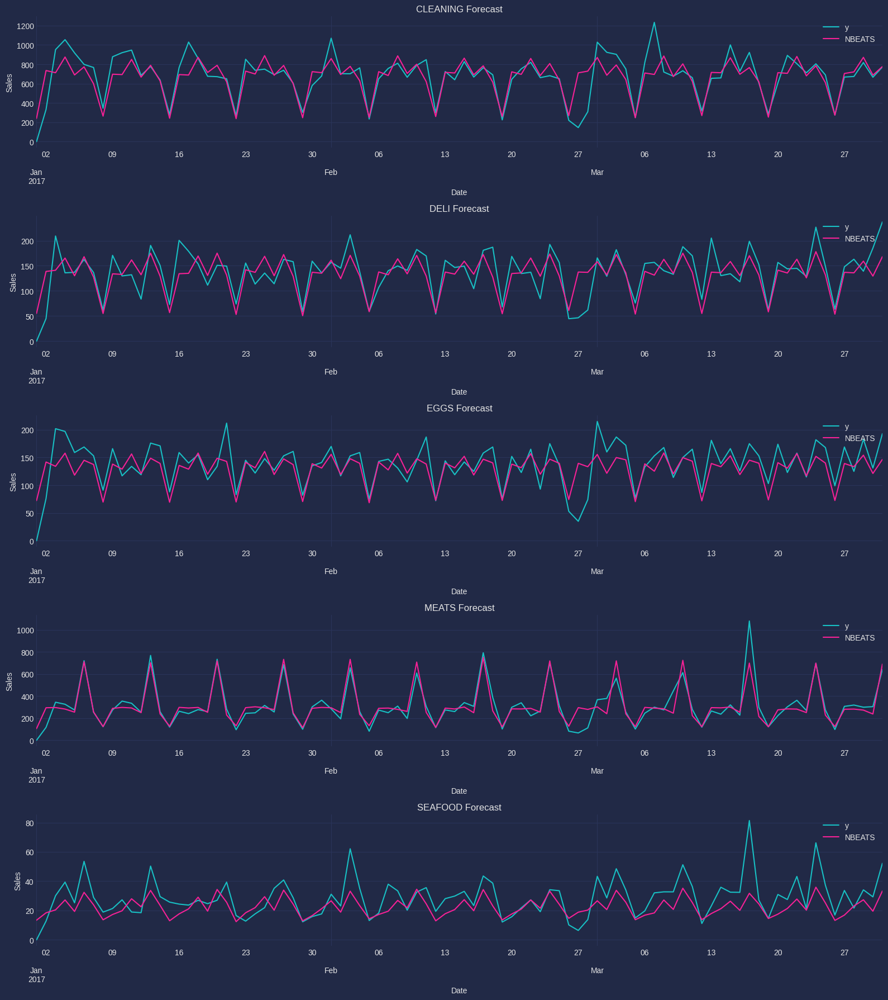

In [59]:
plot_forecasts(pred_nbeats[['ds', 'unique_id', 'y', 'NBEATS']])

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('model_nbeats.pkl', 'wb') as output:
    pickle.dump(model_nbeats, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [62]:
pred_total = pd.merge(pred_total, pred_nbeats[['unique_id', 'ds', 'NBEATS']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,ExtraTreesRegressor,GRU,LGBMRegressor,LSTM,NBEATS,Naive,Prophet,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,,,,,
CLEANING,13.349163,13.729725,14.648318,13.724582,14.542956,14.302041,37.493661,11.554434,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,14.320664,14.851767,15.583643,16.278342,17.412053,26.073904,14.800930,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,12.980869,12.857864,12.898348,13.643039,15.142127,22.446020,10.763817,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.680925,14.489933,15.265199,15.104359,15.909007,50.838618,13.861129,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.268865,23.096465,22.148264,26.972779,29.356084,44.928126,20.399288,23.468644,26.269812,38.189091,41.384415,24.472920


*Модель `N-BEATS` не смогла улучшить качество прогноза по сравнению с предыдущими моделями.*



---



## DeepAR
gpu

Чтобы использовать данные в качестве входных данных для `DeepAR`, нам нужно создать набор данных с классом `PandasDataset`. Для этого потребуется фрейм данных `Pandas` в длинном формате, что означает, что каждая строка представляет собой отдельное наблюдение во времени.
- Первый аргумент - это фрейм данных,
- `target` - имя столбца со значениями временного ряда в качестве целевого,
`item_id` - имя столбца с идентификатором временного ряда,
- `timestamp` - имя столбца с временной меткой,
- `freq` - частота временного ряда.


Гиперпараметры `DeepAR`:
- `num_layers` - количество слоев в RNN,
- `hidden_size` - количество единиц (нейронов) в каждом слое RNN,
- `context_length` - количество временных шагов, которые модель будет использовать в качестве входных данных для прогнозирования следующего временного шага,
- `prediction_length` - количество временных шагов, которые вы хотите предсказать, совпадает с горизонтом прогнозирования,
- `lr` - скорость обучения оптимизатора,
- `weight_decay` - параметр регуляризации для весов во время обучения,
- `dropout_rate` - еще один параметр регуляризации.

Обучим `DeepAR` с использованием нескольких временных рядов в `GluonTS`:
- создаем экземпляр класса `DeepAREstimator`,
- установим `accelerator='gpu'`, чтобы использовать `GPU` для обучения, и `max_epochs=30`, чтобы ограничить количество эпох до `30`.

In [ ]:
train_ds = PandasDataset.from_long_dataframe(train, target='y', item_id='unique_id',
                                             timestamp='ds', freq='D')

estimator = DeepAREstimator(freq='D', prediction_length=h, num_layers=3,
                            trainer_kwargs={'accelerator': 'gpu', 'max_epochs': 30})

predictor = estimator.train(train_ds, num_workers=2)

pred = list(predictor.predict(train_ds))

Training: |          | 0/? [00:00<?, ?it/s]


Делаем прогнозы с помощью `DeepAR` в `GluonTS`.

In [ ]:
pred_deepar = list()

for item in pred:
    family = item.item_id
    p = item.samples.mean(axis=0)
    dates = pd.date_range(start=item.start_date.to_timestamp(), periods=len(p), freq='D')
    family_pred = pd.DataFrame({'ds': dates, 'unique_id': family, 'pred': p})
    pred_deepar += [family_pred]

pred_deepar = pd.concat(pred_deepar, ignore_index=True)
pred_deepar = pred_deepar.merge(valid, on=['ds', 'unique_id'], how='left')
pred_deepar = pred_deepar.rename(columns={'pred': 'DeepAR'})

Построим графики прогнозов моделей и истинных значений.

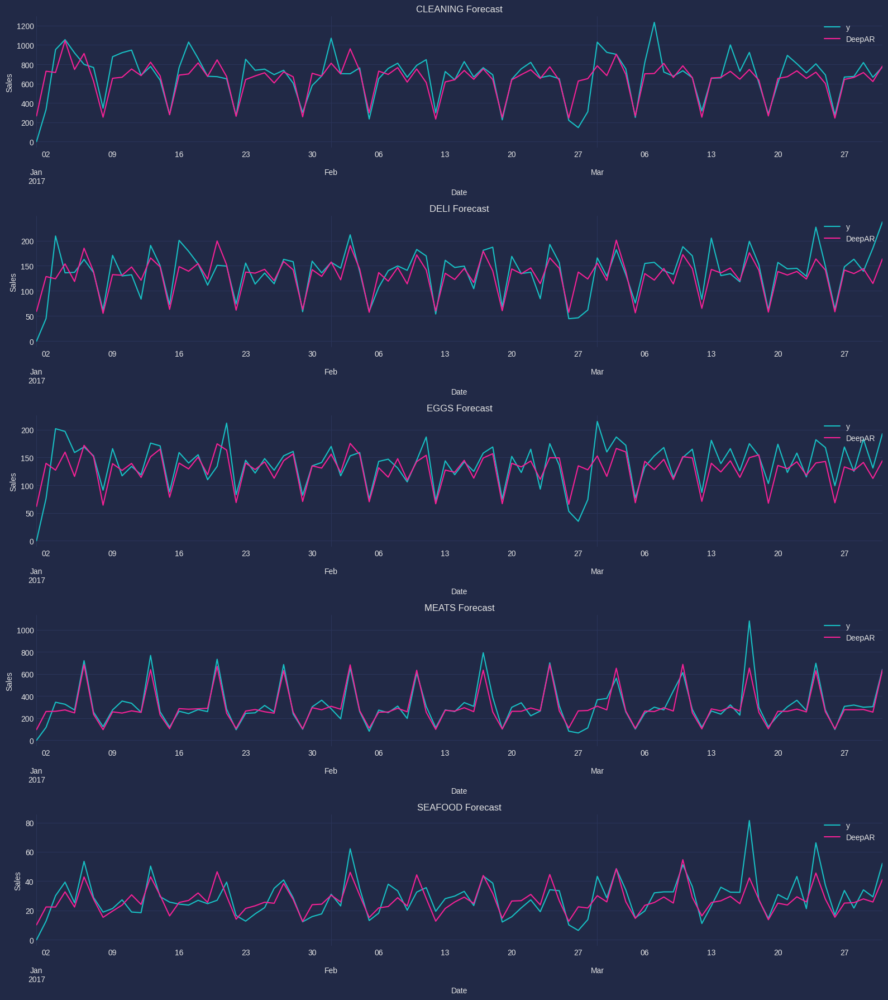

In [61]:
plot_forecasts(pred_deepar[['ds', 'unique_id', 'DeepAR', 'y']])

Сериализуем модель и сохраняем в файл формата `.pkl`.

In [ ]:
with open('pred_deepar.pkl', 'wb') as output:
    pickle.dump(pred_deepar, output)

Дополним сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [66]:
pred_total = pd.merge(pred_total, pred_deepar[['unique_id', 'ds', 'DeepAR']], on=['unique_id', 'ds'])

get_pivot_table(pred_total)

model,AutoARIMA,DeepAR,ExtraTreesRegressor,GRU,LGBMRegressor,LSTM,NBEATS,Naive,Prophet,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,,,,,,
CLEANING,13.349163,14.582808,13.729725,14.648318,13.724582,14.542956,14.302041,37.493661,11.554434,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,15.326889,14.320664,14.851767,15.583643,16.278342,17.412053,26.073904,14.800930,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,14.511832,12.980869,12.857864,12.898348,13.643039,15.142127,22.446020,10.763817,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.499158,15.680925,14.489933,15.265199,15.104359,15.909007,50.838618,13.861129,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.072070,22.268865,23.096465,22.148264,26.972779,29.356084,44.928126,20.399288,23.468644,26.269812,38.189091,41.384415,24.472920


*Модель `N-DeepAR` не смогла улучшить качество прогноза по сравнению с предыдущими моделями.*



---
# 6. Заключение

Напишем функцию для построения графиков прогнозов моделей и истинных значений количества продаж по семействам товаров.

In [81]:
def plot_forecast_by_family(df, family):
    fig, ax = plt.subplots(figsize=(16, 9))
    FAMILY = df[df['unique_id'] == family]
    FAMILY.plot(x='ds', y='y', ax=ax, label='y')
    for model in [col for col in FAMILY.columns if col not in ['ds', 'unique_id', 'y']]:
        FAMILY.plot(x='ds', y=model, ax=ax, label=model)
    ax.legend()
    ax.set_xlabel('Date')
    ax.set_ylabel('Sales')
    ax.set_title(f'{family} Sales Forecast')
    fig.tight_layout()
    plt.show()

Построим графики прогнозов моделей и истинных значений количества продаж по семействам товаров.

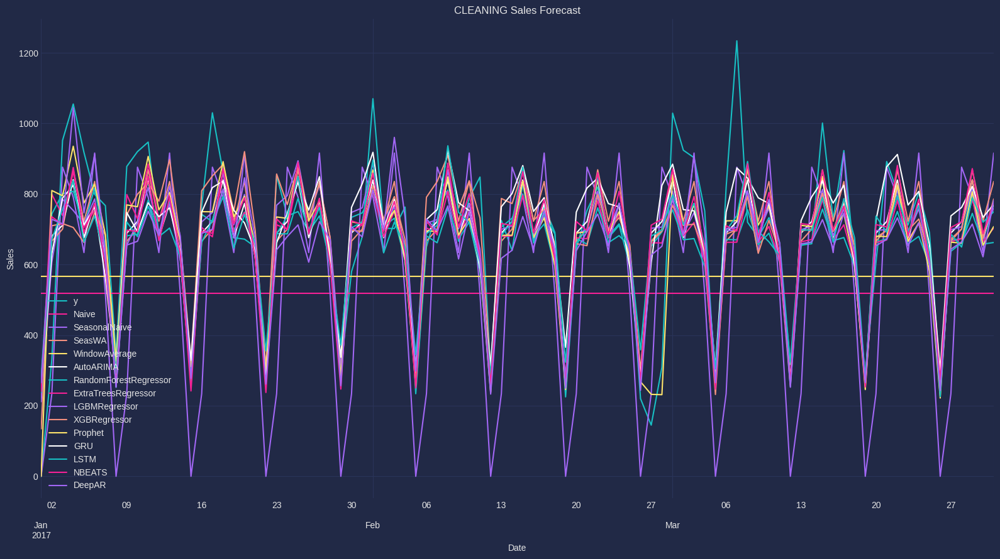

In [82]:
plot_forecast_by_family(pred_total, 'CLEANING')

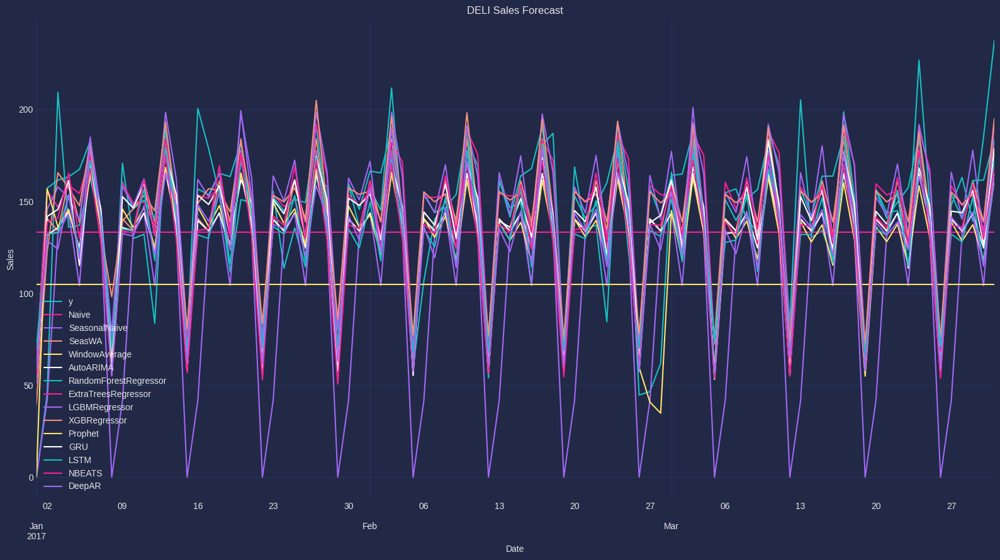

In [70]:
plot_forecast_by_family(pred_total, 'DELI')

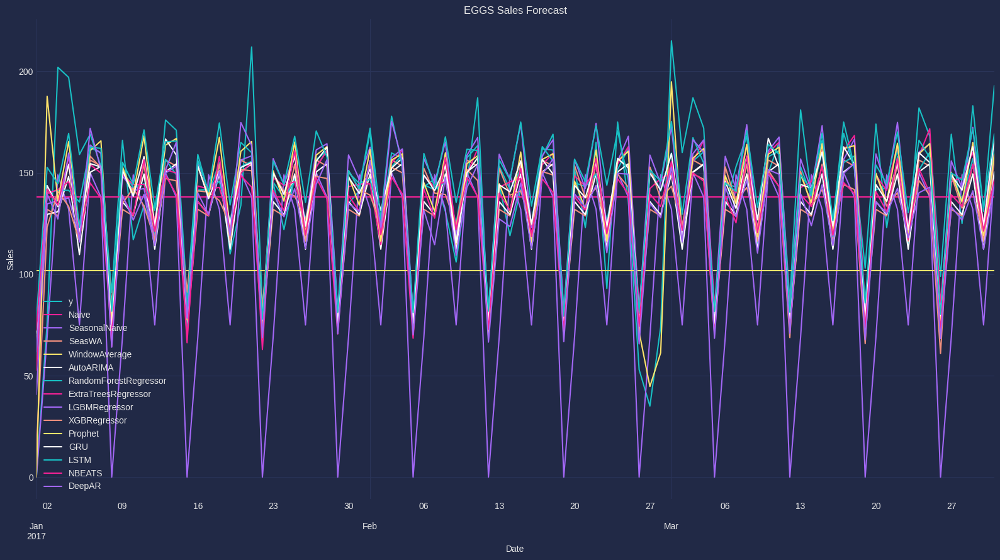

In [71]:
plot_forecast_by_family(pred_total, 'EGGS')

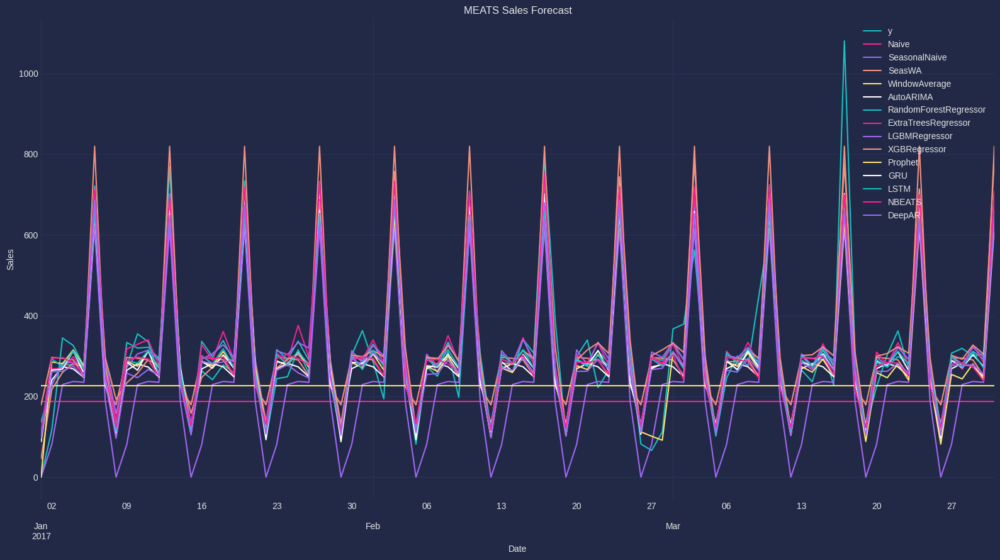

In [72]:
plot_forecast_by_family(pred_total, 'MEATS')

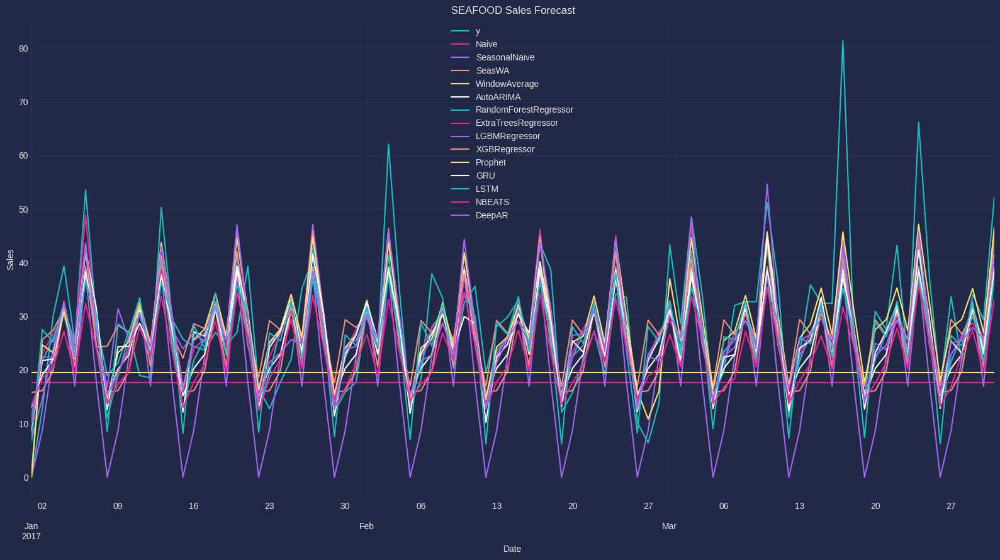

In [73]:
plot_forecast_by_family(pred_total, 'SEAFOOD')

Создадим сводную таблицу с ошибками прогнозов моделей по семействам товаров.

In [88]:
get_pivot_table(pred_total)

model,AutoARIMA,DeepAR,ExtraTreesRegressor,GRU,LGBMRegressor,LSTM,NBEATS,Naive,Prophet,RandomForestRegressor,SeasWA,SeasonalNaive,WindowAverage,XGBRegressor
family,,,,,,,,,,,,,,
CLEANING,13.349163,14.582808,13.729725,14.648318,13.724582,14.542956,14.302041,37.493661,11.554434,14.966509,14.353714,29.054684,32.844781,14.359237
DELI,15.510463,15.326889,14.320664,14.851767,15.583643,16.278342,17.412053,26.073904,14.800930,15.838575,15.713238,27.614895,36.201118,14.540933
EGGS,14.027082,14.511832,12.980869,12.857864,12.898348,13.643039,15.142127,22.446020,10.763817,13.200668,13.800009,31.703190,33.711617,14.394509
MEATS,16.137121,15.499158,15.680925,14.489933,15.265199,15.104359,15.909007,50.838618,13.861129,15.339613,21.915593,30.236218,43.354514,15.226412
SEAFOOD,23.496024,22.072070,22.268865,23.096465,22.148264,26.972779,29.356084,44.928126,20.399288,23.468644,26.269812,38.189091,41.384415,24.472920


Результаты прогнозов моделей показывают, что некоторые модели имеют более низкие значения `WMAPE`, чем другие, что указывает на то, что они лучше предсказывают реальные значения: среди рассмотренных моделей `Prophet` показала лучшие результаты по качеству прогнозов по 4 из 5 семейств товаров. Однако производительность моделей варьируется в разных семействах товаров, и некоторые модели работают лучше для определенных семейств, чем для других.

В целом результаты показывают, что прогнозирующие модели могут быть полезны при предсказании реальных значений семейств товаров, но их производительность может варьироваться в зависимости от конкретного семейства и используемой модели. Дальнейший анализ и эксперименты могут потребоваться для определения наиболее эффективной прогнозирующей модели для каждого семейства товаров.



---

